In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import warnings
from tqdm import tqdm_notebook

warnings.filterwarnings(action='ignore')
%matplotlib inline

# 데이터 전처리

In [ ]:
import pickle

DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

# load
with open(DATA_DIR + 'user_play_game_li_data_v2.pickle', 'rb') as f:
    play_game_li = pickle.load(f)

len(play_game_li)

30379

In [ ]:
DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

Steam_meta_df = pd.read_csv(DATA_DIR + 'Steam_image_meta_data_clean_v2.csv')
Steam_meta_df['game_id'] = Steam_meta_df['game_id'].astype(str)
Steam_meta_df.head()

,game_id,title,content,Image_url,genres,clean_genres
0,768520,Red Solstice 2: Survivors,Sequel to the best-seller ​The Red Solstice​. ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tStrategy RPG\t\t...,"['Strategy RPG', 'Real Time Tactics', 'Charact..."
1,251570,7 Days to Die,7 Days to Die is an open-world game that is a ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tEarly Access\t\t...,"['Early Access', 'Survival', 'Voxel', 'Zombies..."
2,671510,DESOLATE,DESOLATE is a first person horror survival exp...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tSurvival\t\t\t\t...,"['Survival', 'Horror', 'Open World', 'Zombies'..."
3,613590,Dungeon Of Zaar - Open Beta,Dungeon of Zaar is a competitive tactical game...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tStrategy\t\t\t\t...,"['Strategy', 'Indie', 'Free to Play', 'Early A..."
4,374280,Hired Ops,Hired Ops is a session-based online shooter de...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tFPS\t\t\t\t\t\t\...,"['FPS', 'Multiplayer', 'Action', 'Free to Play..."


In [ ]:
Steam_meta_df.shape

(24085, 6)

In [ ]:
# 컨텐트가 존재하지 않는 게임 데이터 리스트
non_content_game_li = Steam_meta_df[Steam_meta_df['content'].isna()]['game_id'].values.tolist()

In [ ]:
# 학습용 데이터 만들기
clean_play_game_li = []
for game_li in play_game_li:
  ret = []
  for game in game_li:
    if game not in non_content_game_li:
      ret.append(game)
    
  if len(ret) >= 5 :
    clean_play_game_li.append(ret)

len(clean_play_game_li)

29980

컨텐츠가 존재하지 않고 (왜? 나중에 합친다고 했을 때 컨텐트가 존재해야 맵핑이 가능하므로) 시퀀스가 5이상인 데이터만 사용(왜? 학습을 위한 기본 시퀀스를 5로 생각함 에어비앤비 논문 참고)

In [ ]:
# game_id2title
game_id2title = {}

# game_id2content
game_id2content = {}

# game_id2clean_genres
game_id2clean_genres = {}

def get_2data(x):
  game_id2title[x['game_id']] = x['title']
  game_id2content[x['game_id']] = x['content']
  game_id2clean_genres[x['game_id']] = x['clean_genres']

_ = Steam_meta_df.apply(lambda x : get_2data(x), axis = 1)

# 모델 학습

In [ ]:
from gensim.models import Word2Vec
model = Word2Vec(sentences = clean_play_game_li, size = 100, window = 5, min_count = 5, workers = 4, sg = 0, iter = 100)

# 100번 반복에 약 5분 정도 시간이 걸림

In [ ]:
from gensim.models import KeyedVectors

# model.wv.save_word2vec_format(DATA_DIR + 'Prod2Vec_model') # 모델 저장
loaded_model = KeyedVectors.load_word2vec_format(DATA_DIR + "Prod2Vec_model") # 모델 로드

# 평가

In [ ]:
DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

Steam_meta_df = pd.read_csv(DATA_DIR + 'Steam_image_meta_data_clean_v2.csv')
Steam_meta_df['game_id'] = Steam_meta_df['game_id'].astype(str)
Steam_meta_df.head()

,game_id,title,content,Image_url,genres,clean_genres
0,768520,Red Solstice 2: Survivors,Sequel to the best-seller ​The Red Solstice​. ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tStrategy RPG\t\t...,"['Strategy RPG', 'Real Time Tactics', 'Charact..."
1,251570,7 Days to Die,7 Days to Die is an open-world game that is a ...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tEarly Access\t\t...,"['Early Access', 'Survival', 'Voxel', 'Zombies..."
2,671510,DESOLATE,DESOLATE is a first person horror survival exp...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tSurvival\t\t\t\t...,"['Survival', 'Horror', 'Open World', 'Zombies'..."
3,613590,Dungeon Of Zaar - Open Beta,Dungeon of Zaar is a competitive tactical game...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tStrategy\t\t\t\t...,"['Strategy', 'Indie', 'Free to Play', 'Early A..."
4,374280,Hired Ops,Hired Ops is a session-based online shooter de...,https://cdn.akamai.steamstatic.com/steam/apps/...,\n\r\n\t\t\t\t\t\t\t\t\t\t\t\tFPS\t\t\t\t\t\t\...,"['FPS', 'Multiplayer', 'Action', 'Free to Play..."


In [ ]:
# game_id2title
game_id2title = {}

# game_id2content
game_id2content = {}

# game_id2clean_genres
game_id2clean_genres = {}

def get_2data(x):
  game_id2title[x['game_id']] = x['title']
  game_id2content[x['game_id']] = x['content']
  game_id2clean_genres[x['game_id']] = x['clean_genres']

_ = Steam_meta_df.apply(lambda x : get_2data(x), axis = 1)

In [ ]:
from gensim.models import KeyedVectors

loaded_model = KeyedVectors.load_word2vec_format(DATA_DIR + "Prod2Vec_model") # 모델 로드

In [ ]:
import pickle

DATA_DIR = '/content/drive/MyDrive/투빅스 컨퍼런스/Data/'

image_dict = {}

# load
for i in range(5):
  with open(DATA_DIR + f'image_data_dict_v2_{i + 1}.pickle', 'rb') as f:
      image = pickle.load(f)
      
  image_dict.update(image)

len(image_dict)

22458

In [ ]:
from PIL import Image

def get_sim_game(model, game_id):
  choise_game_title = game_id2title[game_id]
  choise_game_content = game_id2content[game_id]
  choise_game_clean_genres = game_id2clean_genres[game_id]
  
  print('-'*100)
  print(f'선택된 게임의 ID: {game_id}, 선택된 게임의 title: {choise_game_title}')
  print(f'선택된 게임의 content: {choise_game_content}')
  print(f'선택된 게임의 genres: {choise_game_clean_genres}')
  img = Image.fromarray(image_dict[int(game_id)])
  display(img)
  print('-'*100)

  sim_game_li = model.most_similar_cosmul(game_id)
  for idx, (sim_game_id, sim_score) in enumerate(sim_game_li):

    sim_game_title = game_id2title[sim_game_id]
    sim_game_content = game_id2content[sim_game_id]
    sim_game_clean_genres = game_id2clean_genres[sim_game_id]

    print('-'*100)
    print(f'TOP{idx + 1} 게임의 ID: {sim_game_id}, title: {sim_game_title}, Score: {sim_score}')
    print(f'선택된 게임의 content: {sim_game_content}')
    print(f'선택된 게임의 genres: {sim_game_clean_genres}')
    img = Image.fromarray(image_dict[int(sim_game_id)])
    display(img)
    print('-'*100)

## BioShock™

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 7670, 선택된 게임의 title: BioShock™
선택된 게임의 content: BioShock is a shooter unlike any you've ever played, loaded with weapons and tactics never seen. You'll have a complete arsenal at your disposal from simple revolvers to grenade launchers and chemical throwers, but you'll also be forced to genetically modify your DNA to create an even more deadly weapon: you.
선택된 게임의 genres: ['FPS', 'Atmospheric', 'Story Rich', 'Action', 'Singleplayer', 'Horror', 'Steampunk', 'First-Person', 'Shooter', 'Sci-fi', 'RPG', 'Classic', 'Adventure', 'Dystopian ', 'Underwater', 'Immersive', 'Dark', 'Political', 'Great Soundtrack', 'Alternate History']


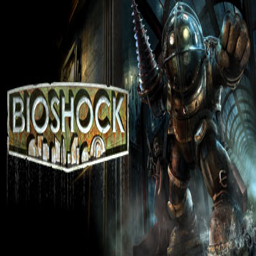

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 225080, title: Brothers - A Tale of Two Sons, Score: 0.7548143863677979
선택된 게임의 content: Guide two brothers on an epic fairy tale journey from visionary Swedish film director, Josef Fares and top-tier developer Starbreeze Studios. Control both brothers at once as you experience co-op play in single player mode, like never before.
선택된 게임의 genres: ['Adventure', 'Atmospheric', 'Story Rich', 'Controller', 'Indie', 'Emotional', 'Puzzle', 'Short', 'Fantasy', 'Singleplayer', 'Beautiful', 'Great Soundtrack', 'Action', 'Local Co-Op', 'Platformer', 'Third Person', 'Multiplayer', 'Casual', '3D Vision', 'Walking Simulator']


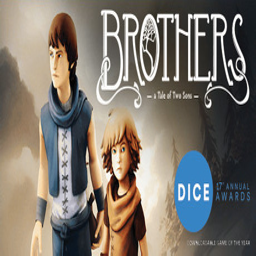

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 8980, title: Borderlands Game of the Year, Score: 0.7449690103530884
선택된 게임의 content: Get ready for the mind blowing insanity! Play as one of four trigger-happy mercenaries and take out everything that stands in your way! With its addictive action, frantic first-person shooter combat, massive arsenal of weaponry, RPG elements and four-player co-op, Borderlands is a breakthrough experience that challenges all the...
선택된 게임의 genres: ['Looter Shooter', 'FPS', 'Co-op', 'RPG', 'Action', 'Loot', 'Shooter', 'Online Co-Op', 'First-Person', 'Open World', 'Comedy', 'Multiplayer', 'Sci-fi', 'Post-apocalyptic', 'Singleplayer', 'Action RPG', 'Funny', 'Dark Humor', 'Adventure', 'Gore']


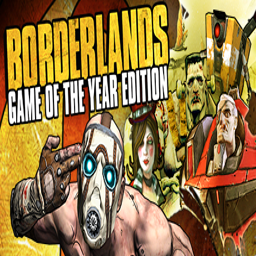

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 205100, title: Dishonored, Score: 0.7380874156951904
선택된 게임의 content: Dishonored is an immersive first-person action game that casts you as a supernatural assassin driven by revenge. With Dishonored’s flexible combat system, creatively eliminate your targets as you combine the supernatural abilities, weapons and unusual gadgets at your disposal.
선택된 게임의 genres: ['Stealth', 'First-Person', 'Action', 'Steampunk', 'Assassin', 'Singleplayer', 'Atmospheric', 'Story Rich', 'Adventure', 'Multiple Endings', 'Dark', 'Magic', 'Dystopian ', 'FPS', 'RPG', 'Replay Value', 'Fantasy', 'Open World', 'Immersive Sim', 'Shooter']


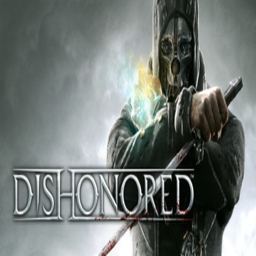

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 12900, title: AudioSurf, Score: 0.7375882863998413
선택된 게임의 content: Ride your music. Audiosurf is a music-adapting puzzle racer where you use your own music to create your own experience. The shape, the speed, and the mood of each ride is determined by the song you choose.
선택된 게임의 genres: ['Music', 'Rhythm', 'Indie', 'Casual', 'Music-Based Procedural Generation', 'Arcade', 'Colorful', 'Singleplayer', 'Relaxing', 'Score Attack', 'Addictive', 'Local Co-Op', 'Procedural Generation', 'Replay Value', 'Puzzle', 'Great Soundtrack', 'Fast-Paced', 'Racing', 'Co-op', 'Local Multiplayer']


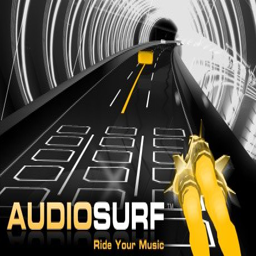

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 17460, title: Mass Effect (2007), Score: 0.7372365593910217
선택된 게임의 content: As Commander Shepard, you lead an elite squad on a heroic, action-packed adventure throughout the galaxy. Discover the imminent danger from an ancient threat and battle the traitorous Saren and his deadly army to save civilization. The fate of all life depends on your actions!
선택된 게임의 genres: ['RPG', 'Sci-fi', 'Story Rich', 'Action', 'Space', 'Third-Person Shooter', 'Singleplayer', 'Great Soundtrack', 'Choices Matter', 'Third Person', 'Character Customization', 'Shooter', 'Female Protagonist', 'Adventure', 'Romance', 'Atmospheric', 'Open World', 'Real-Time with Pause', 'Action RPG', 'Immersive']


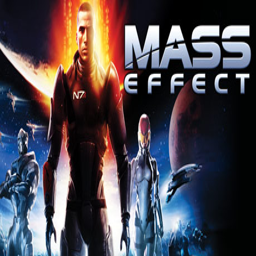

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 203810, title: Dear Esther, Score: 0.7325752973556519
선택된 게임의 content: Begin a journey through one of the most original first-person games of recent years.
선택된 게임의 genres: ['Walking Simulator', 'Indie', 'Exploration', 'First-Person', 'Atmospheric', 'Short', 'Story Rich', 'Casual', 'Adventure', 'Great Soundtrack', 'Singleplayer', 'Narration', 'Mystery', 'Relaxing', 'Beautiful', 'Experimental', 'Interactive Fiction', 'Soundtrack', 'Linear', 'Emotional']


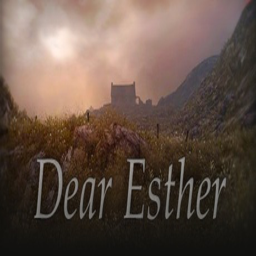

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 327410, title: A Bird Story, Score: 0.7280700206756592
선택된 게임의 content: An experimental short from the creator of To the Moon & Finding Paradise: A simple & surreal 1-hour interactive animation about a boy and an injured bird, told without dialogues.
선택된 게임의 genres: ['Indie', 'Story Rich', 'Great Soundtrack', 'Pixel Graphics', 'Short', 'RPGMaker', 'Adventure', 'Singleplayer', 'Interactive Fiction', '2D', 'RPG', 'Atmospheric', 'Visual Novel', 'Retro', 'Emotional', 'Casual', 'Walking Simulator', 'Surreal', 'Top-Down', 'Cute']


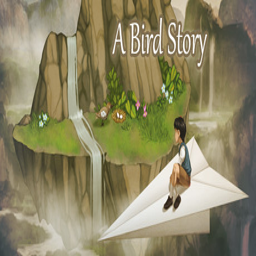

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 17410, title: Mirror's Edge™, Score: 0.7279058694839478
선택된 게임의 content: In a city where information is heavily monitored, couriers called Runners transport sensitive data. In this seemingly utopian paradise, a crime has been committed, & you are being hunted. You are a Runner called Faith and this innovative first-person action-adventure is your story.
선택된 게임의 genres: ['Parkour', 'First-Person', 'Action', 'Female Protagonist', 'Singleplayer', 'Great Soundtrack', 'Adventure', 'Platformer', 'Atmospheric', 'Dystopian ', 'Stylized', 'Futuristic', 'Sci-fi', 'FPS', 'Cyberpunk', 'Colorful', 'Puzzle', 'Time Attack', 'Classic', 'Short']


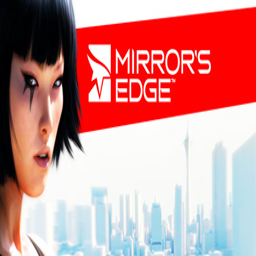

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 8870, title: BioShock Infinite, Score: 0.7238892912864685
선택된 게임의 content: Indebted to the wrong people, with his life on the line, veteran of the U.S. Cavalry and now hired gun, Booker DeWitt has only one opportunity to wipe his slate clean. He must rescue Elizabeth, a mysterious girl imprisoned since childhood and locked up in the flying city of Columbia.
선택된 게임의 genres: ['FPS', 'Story Rich', 'Action', 'Singleplayer', 'Steampunk', 'Atmospheric', 'Shooter', 'First-Person', 'Alternate History', 'Beautiful', 'Adventure', 'Great Soundtrack', 'Dystopian ', 'Sci-fi', 'Time Travel', 'Fantasy', 'Gore', 'Linear', 'RPG', 'Immersive']


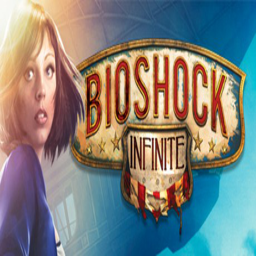

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 203750, title: Binary Domain, Score: 0.7235967516899109
선택된 게임의 content: Set in futuristic Tokyo, take control of the robotic community before they control everything!
선택된 게임의 genres: ['Action', 'Third-Person Shooter', 'Sci-fi', 'Cyberpunk', 'Robots', 'Shooter', 'Story Rich', 'Third Person', 'Transhumanism', 'Singleplayer', 'Futuristic', 'Adventure', 'Co-op', 'Multiplayer', 'Dystopian ', 'Controller', 'Voice Control', 'Atmospheric', 'RPG', 'Great Soundtrack']


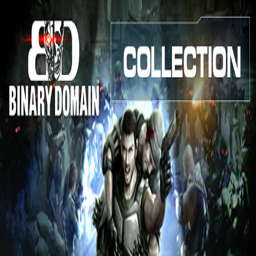

----------------------------------------------------------------------------------------------------


In [ ]:
# BioShock™
get_sim_game(loaded_model, '7670')

## Sekiro™: Shadows Die Twice - GOTY Edition

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 814380, 선택된 게임의 title: Sekiro™: Shadows Die Twice - GOTY Edition
선택된 게임의 content: Game of the Year - The Game Awards 2019 Best Action Game of 2019 - IGN Carve your own clever path to vengeance in the award winning adventure from developer FromSoftware, creators of Bloodborne and the Dark Souls series. Take Revenge. Restore Your Honor. Kill Ingeniously.
선택된 게임의 genres: ['Souls-like', 'Difficult', 'Action', 'Singleplayer', 'Ninja', 'Stealth', 'Adventure', 'Third Person', 'Open World', 'Story Rich', 'Atmospheric', 'Violent', 'Assassin', 'Dark Fantasy', 'Great Soundtrack', 'Hack and Slash', 'RPG', 'Gore', 'Dark', 'Rhythm']


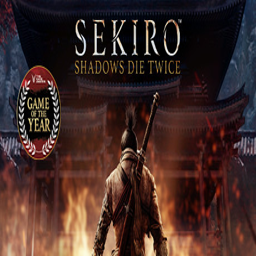

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 601150, title: Devil May Cry 5, Score: 0.8069729208946228
선택된 게임의 content: The ultimate Devil Hunter is back in style, in the game action fans have been waiting for.
선택된 게임의 genres: ['Action', 'Hack and Slash', 'Great Soundtrack', 'Character Action Game', 'Demons', 'Spectacle fighter', 'Third Person', 'Singleplayer', 'Violent', 'Stylized', 'Classic', 'Gore', 'Story Rich', 'Nudity', 'Multiplayer', 'Difficult', 'Controller', 'Adventure', 'Anime', 'Co-op']


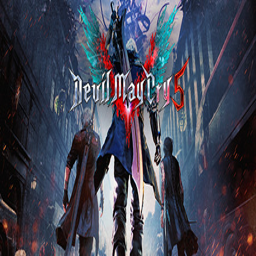

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 570940, title: DARK SOULS™: REMASTERED, Score: 0.7799636721611023
선택된 게임의 content: Then, there was fire. Re-experience the critically acclaimed, genre-defining game that started it all. Beautifully remastered, return to Lordran in stunning high-definition detail running at 60fps.
선택된 게임의 genres: ['Souls-like', 'Education', 'Dark Fantasy', 'Action', 'Dark', 'RPG', 'Difficult', 'Fantasy', 'Atmospheric', 'Action RPG', 'Great Soundtrack', 'Multiplayer', 'Lore-Rich', 'Adventure', 'Story Rich', 'Replay Value', 'Third Person', 'Exploration', 'Character Customization', 'Soundtrack']


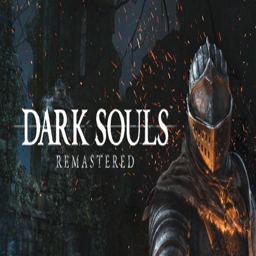

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 752590, title: A Plague Tale: Innocence, Score: 0.7695246934890747
선택된 게임의 content: Follow the grim tale of young Amicia and her little brother Hugo, in a heartrending journey through the darkest hours of history.
선택된 게임의 genres: ['Story Rich', 'Adventure', 'Female Protagonist', 'Medieval', 'Stealth', 'Atmospheric', 'Singleplayer', 'Action', 'Third Person', 'Dark', 'Great Soundtrack', 'Horror', 'Historical', 'Violent', 'Emotional', 'Survival', 'Puzzle', 'Dark Fantasy', 'Post-apocalyptic', 'Walking Simulator']


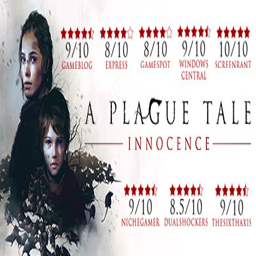

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 582010, title: Monster Hunter: World, Score: 0.7601270079612732
선택된 게임의 content: Welcome to a new world! In Monster Hunter: World, the latest installment in the series, you can enjoy the ultimate hunting experience, using everything at your disposal to hunt monsters in a new world teeming with surprises and excitement.
선택된 게임의 genres: ['Co-op', 'Multiplayer', 'Action', 'Open World', 'RPG', 'Third Person', 'Character Customization', 'Adventure', 'Fantasy', 'Difficult', 'Singleplayer', 'Action RPG', 'Exploration', 'Great Soundtrack', 'Replay Value', 'Atmospheric', 'Hack and Slash', 'JRPG', 'Souls-like', 'MMORPG']


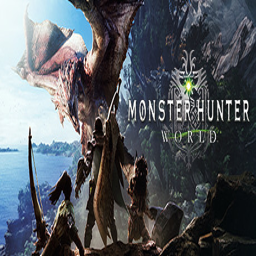

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 976730, title: Halo: The Master Chief Collection, Score: 0.7537709474563599
선택된 게임의 content: The Master Chief’s iconic journey includes six games, built for PC and collected in a single integrated experience. Whether you’re a long-time fan or meeting Spartan 117 for the first time, The Master Chief Collection is the definitive Halo gaming experience.
선택된 게임의 genres: ['Great Soundtrack', 'FPS', 'Classic', 'Multiplayer', 'Story Rich', 'Sci-fi', 'Co-op', 'First-Person', 'Epic', 'Action', 'Shooter', 'Lore-Rich', 'Aliens', 'Singleplayer', 'Beautiful', 'Space', 'Atmospheric', 'Adventure', 'Horror', 'Online Co-Op']


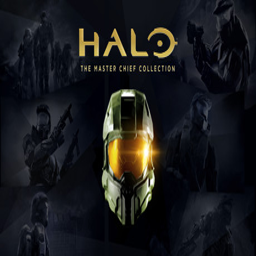

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 374320, title: DARK SOULS™ III, Score: 0.753433883190155
선택된 게임의 content: Dark Souls continues to push the boundaries with the latest, ambitious chapter in the critically-acclaimed and genre-defining series. Prepare yourself and Embrace The Darkness!
선택된 게임의 genres: ['Souls-like', 'Dark Fantasy', 'Difficult', 'RPG', 'Atmospheric', 'Lore-Rich', 'Third Person', 'Exploration', 'Story Rich', 'Action RPG', 'Co-op', 'Great Soundtrack', 'Adventure', 'Action', 'PvP', 'Multiplayer', 'Open World', 'Singleplayer', 'Replay Value', 'Character Customization']


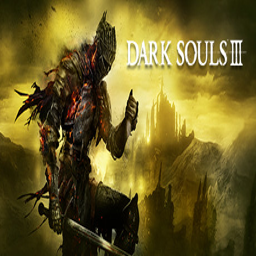

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 485510, title: Nioh: Complete Edition / 仁王 Complete Edition, Score: 0.7530866265296936
선택된 게임의 content: Ready to die? Experience the newest brutal action game from Team NINJA and Koei Tecmo Games. In the age of samurai, a lone traveler lands on the shores of Japan. He must fight his way through the vicious warriors and supernatural Yokai that infest the land in order to find that which he seeks.
선택된 게임의 genres: ['Souls-like', 'Action', 'RPG', 'Difficult', 'Hack and Slash', 'Dark Fantasy', 'Ninja', 'Third Person', 'JRPG', 'Action RPG', 'Singleplayer', 'Co-op', 'Multiplayer', 'Historical', 'Loot', 'Fantasy', 'Adventure', 'Atmospheric', 'Nudity', 'Great Soundtrack']


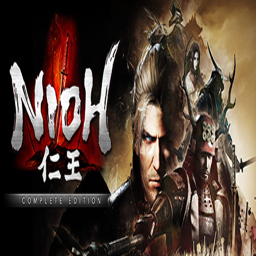

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 1172380, title: STAR WARS Jedi: Fallen Order™, Score: 0.7529124021530151
선택된 게임의 content: A galaxy-spanning adventure awaits in Star Wars Jedi: Fallen Order, a 3rd person action-adventure title from Respawn. An abandoned Padawan must complete his training, develop new powerful Force abilities, and master the art of the lightsaber - all while staying one step ahead of the Empire.
선택된 게임의 genres: ['Action-Adventure', 'Third Person', 'Souls-like', 'Swordplay', 'Platformer', 'Open World', 'Exploration', 'Story Rich', 'RPG', 'Metroidvania', 'Fighting', 'Action', 'Sci-fi', 'Space', 'Fantasy', 'Puzzle', 'Hack and Slash', 'Adventure', 'Atmospheric', 'Family Friendly']


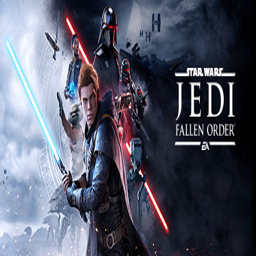

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 683320, title: GRIS, Score: 0.7467899322509766
선택된 게임의 content: Gris is a hopeful young girl lost in her own world, dealing with a painful experience in her life. Her journey through sorrow is manifested in her dress, which grants new abilities to better navigate her faded reality.
선택된 게임의 genres: ['Beautiful', 'Atmospheric', 'Great Soundtrack', 'Indie', 'Female Protagonist', 'Adventure', 'Hand-drawn', 'Singleplayer', '2D', 'Platformer', 'Relaxing', 'Story Rich', 'Puzzle', 'Colorful', 'Puzzle Platformer', 'Surreal', 'Casual', 'Exploration', 'Anime', 'Walking Simulator']


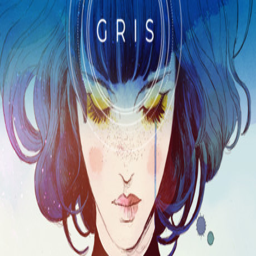

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 557340, title: My Friend Pedro, Score: 0.7437995672225952
선택된 게임의 content: My Friend Pedro is a violent ballet about friendship, imagination, and one man’s struggle to obliterate anyone in his path at the behest of a sentient banana.
선택된 게임의 genres: ['Action', 'Indie', 'Shooter', 'Parkour', 'Violent', 'Bullet Time', 'Great Soundtrack', 'Gore', 'Singleplayer', 'Side Scroller', 'Platformer', 'Fast-Paced', 'Funny', 'Comedy', '2.5D', 'Blood', 'Physics', '2D', 'Controller', 'Multiplayer']


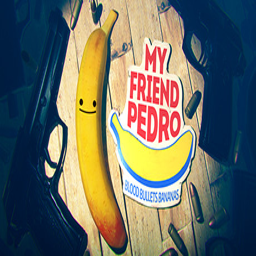

----------------------------------------------------------------------------------------------------


In [ ]:
# Sekiro™: Shadows Die Twice - GOTY Edition
get_sim_game(loaded_model, '814380')

## The Witcher® 3: Wild Hunt

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 292030, 선택된 게임의 title: The Witcher® 3: Wild Hunt
선택된 게임의 content: As war rages on throughout the Northern Realms, you take on the greatest contract of your life — tracking down the Child of Prophecy, a living weapon that can alter the shape of the world.
선택된 게임의 genres: ['Open World', 'RPG', 'Story Rich', 'Atmospheric', 'Mature', 'Fantasy', 'Adventure', 'Singleplayer', 'Choices Matter', 'Nudity', 'Great Soundtrack', 'Third Person', 'Action', 'Medieval', 'Multiple Endings', 'Action RPG', 'Magic', 'Dark Fantasy', 'Dark', 'Sandbox']


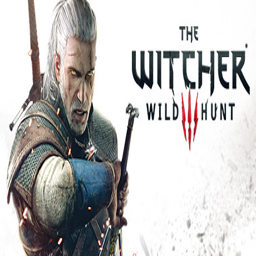

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 460930, title: Tom Clancy's Ghost Recon® Wildlands, Score: 0.744381308555603
선택된 게임의 content: Create a team with up to 3 friends in Tom Clancy’s Ghost Recon® Wildlands and enjoy the ultimate military shooter experience set in a massive, dangerous, and responsive open world.
선택된 게임의 genres: ['Open World', 'Shooter', 'Co-op', 'Action', 'Multiplayer', 'Tactical', 'Stealth', 'Third-Person Shooter', 'Singleplayer', 'Military', 'FPS', 'Online Co-Op', 'Adventure', 'Third Person', 'Survival', 'Strategy', 'Sandbox', 'First-Person', 'Atmospheric', 'PvP']


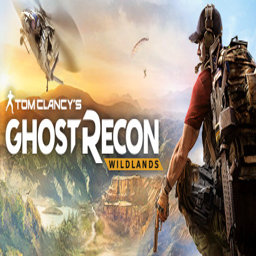

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 234140, title: Mad Max, Score: 0.7441611886024475
선택된 게임의 content: Play as Mad Max, a reluctant hero and survivor who wants nothing more than to leave the madness behind and find solace.
선택된 게임의 genres: ['Open World', 'Vehicular Combat', 'Action', 'Post-apocalyptic', 'Driving', 'Singleplayer', 'Survival', 'Third Person', 'Adventure', 'Automobile Sim', 'Exploration', 'Racing', 'Atmospheric', 'Story Rich', 'Sandbox', 'RPG', 'Shooter', 'Third-Person Shooter', 'Multiplayer', 'War']


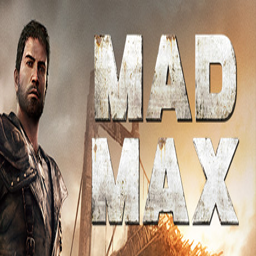

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 241930, title: Middle-earth™: Shadow of Mordor™, Score: 0.739827573299408
선택된 게임의 content: Fight through Mordor and uncover the truth of the spirit that compels you, discover the origins of the Rings of Power, build your legend and ultimately confront the evil of Sauron in this new chronicle of Middle-earth.
선택된 게임의 genres: ['Open World', 'Action', 'Fantasy', 'Adventure', 'Third Person', 'Stealth', 'Singleplayer', 'RPG', 'Action RPG', 'Assassin', 'Hack and Slash', 'Gore', 'Parkour', 'Story Rich', 'Atmospheric', 'Magic', 'Dark Fantasy', 'Lore-Rich', 'Based On A Novel', 'Sandbox']


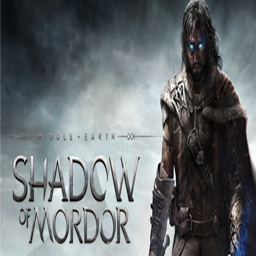

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 364360, title: Total War: WARHAMMER, Score: 0.7391071915626526
선택된 게임의 content: Addictive turn-based empire-building with colossal, real-time battles, all set in a world of legendary heroes, giant monsters, flying creatures and storms of magical power.
선택된 게임의 genres: ['Strategy', 'Fantasy', 'RTS', 'War', 'Turn-Based Strategy', 'Games Workshop', 'Grand Strategy', 'Multiplayer', 'Tactical', 'Action', 'Dark Fantasy', 'Singleplayer', 'Turn-Based', 'Atmospheric', 'Co-op', 'Story Rich', 'Open World', 'RPG', 'Gore', 'Warhammer 40K']


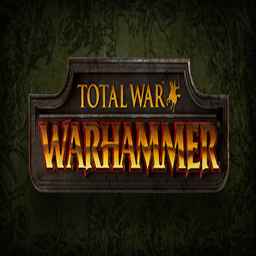

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 239140, title: Dying Light, Score: 0.7387933731079102
선택된 게임의 content: First-person action survival game set in a post-apocalyptic open world overrun by flesh-hungry zombies. Roam a city devastated by a mysterious virus epidemic. Scavenge for supplies, craft weapons, and face hordes of the infected.
선택된 게임의 genres: ['Zombies', 'Survival Horror', 'Horror', 'Online Co-Op', 'Open World', 'Parkour', 'First-Person', 'Open World Survival Craft', 'Survival', 'Action', 'FPS', 'Gore', 'PvP', 'PvE', 'Stealth', 'Post-apocalyptic', 'Story Rich', 'Hack and Slash', 'Action RPG', 'RPG']


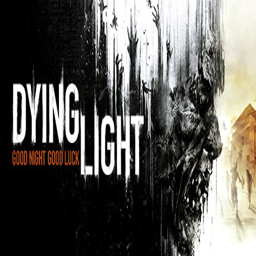

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 208650, title: Batman™: Arkham Knight, Score: 0.736663818359375
선택된 게임의 content: Batman™: Arkham Knight brings the award-winning Arkham trilogy from Rocksteady Studios to its epic conclusion. Developed exclusively for New-Gen platforms, Batman: Arkham Knight introduces Rocksteady's uniquely designed version of the Batmobile.
선택된 게임의 genres: ['Action', 'Open World', 'Superhero', 'Stealth', 'Adventure', 'Third Person', 'Singleplayer', 'Detective', 'Fighting', 'Story Rich', 'Atmospheric', 'Dark', 'Comic Book', "Beat 'em up", 'Puzzle', 'Mature', 'Strategy', 'Sandbox', 'Horror', 'Epic']


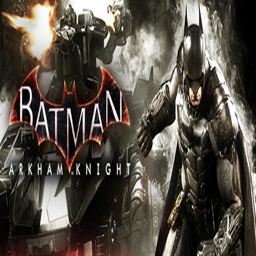

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 271590, title: Grand Theft Auto V, Score: 0.7331410646438599
선택된 게임의 content: Grand Theft Auto V for PC offers players the option to explore the award-winning world of Los Santos and Blaine County in resolutions of up to 4k and beyond, as well as the chance to experience the game running at 60 frames per second.
선택된 게임의 genres: ['Open World', 'Action', 'Multiplayer', 'Automobile Sim', 'Crime', 'Third Person', 'First-Person', 'Shooter', 'Adventure', 'Mature', 'Singleplayer', 'Third-Person Shooter', 'Racing', 'Co-op', 'Atmospheric', 'Sandbox', 'Funny', 'Great Soundtrack', 'Comedy', 'Moddable']


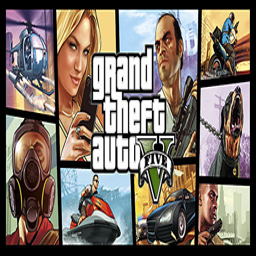

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 287700, title: METAL GEAR SOLID V: THE PHANTOM PAIN, Score: 0.7293509244918823
선택된 게임의 content: Ushering in a new era for the METAL GEAR franchise with cutting-edge technology powered by the Fox Engine, METAL GEAR SOLID V: The Phantom Pain, will provide players a first-rate gaming experience as they are offered tactical freedom to carry out open-world missions.
선택된 게임의 genres: ['Stealth', 'Open World', 'Action', 'Story Rich', 'Tactical', 'Cinematic', 'Great Soundtrack', 'Third Person', 'Singleplayer', 'Atmospheric', 'Adventure', 'Horses', 'Multiplayer', 'Third-Person Shooter', 'Shooter', 'Replay Value', 'Sandbox', 'Dark', 'Sci-fi', 'Heist']


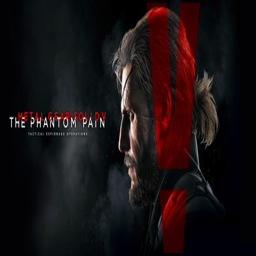

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 262060, title: Darkest Dungeon®, Score: 0.728684663772583
선택된 게임의 content: Darkest Dungeon is a challenging gothic roguelike turn-based RPG about the psychological stresses of adventuring. Recruit, train, and lead a team of flawed heroes against unimaginable horrors, stress, disease, and the ever-encroaching dark. Can you keep your heroes together when all hope is lost?
선택된 게임의 genres: ['Turn-Based Combat', 'Dark Fantasy', 'Dungeon Crawler', 'RPG', 'Roguelike', 'Lovecraftian', 'Difficult', 'Turn-Based', 'Singleplayer', 'Perma Death', 'Strategy', 'Atmospheric', 'Dark', 'Indie', '2D', 'Roguelite', 'Horror', 'Gothic', 'Fantasy', 'Kickstarter']


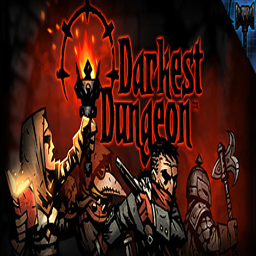

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 225540, title: Just Cause™ 3, Score: 0.7281769514083862
선택된 게임의 content: With over 1000 km² of complete freedom from sky to seabed, Rico Rodriguez returns to unleash chaos in the most creative and explosive ways imaginable.
선택된 게임의 genres: ['Open World', 'Action', 'Destruction', 'Third-Person Shooter', 'Multiplayer', 'Singleplayer', 'Adventure', 'Shooter', 'Sandbox', 'Third Person', 'Exploration', 'Physics', 'Funny', 'Atmospheric', 'Co-op', 'Parkour', 'Comedy', 'Great Soundtrack', 'Moddable', 'RPG']


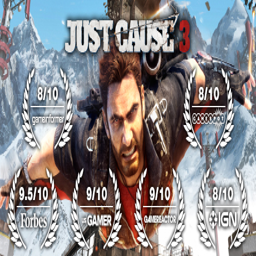

----------------------------------------------------------------------------------------------------


In [ ]:
# The Witcher® 3: Wild Hunt
get_sim_game(loaded_model, '292030')

## Cities: Skylines

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 255710, 선택된 게임의 title: Cities: Skylines
선택된 게임의 content: Cities: Skylines is a modern take on the classic city simulation. The game introduces new game play elements to realize the thrill and hardships of creating and maintaining a real city whilst expanding on some well-established tropes of the city building experience.
선택된 게임의 genres: ['City Builder', 'Simulation', 'Building', 'Strategy', 'Management', 'Sandbox', 'Singleplayer', 'Moddable', 'Economy', 'Resource Management', 'Mod', 'Realistic', 'Replay Value', 'Casual', 'Modern', 'Real-Time with Pause', 'Family Friendly', 'Great Soundtrack', 'Funny', 'Action']


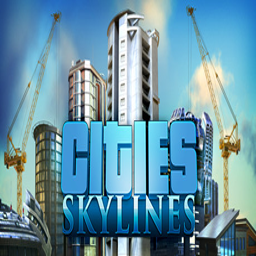

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 346010, title: Besiege, Score: 0.7893180251121521
선택된 게임의 content: Besiege is a physics based building game in which you construct medieval siege engines. Battle your way through a 54 level singleplayer campaign, unleash chaos with your friends in multiplayer, create your own worlds with the level editor, customize your game with mods through the workshop.
선택된 게임의 genres: ['Building', 'Sandbox', 'Physics', 'Destruction', 'Puzzle', 'Medieval', 'Simulation', 'Multiplayer', 'Strategy', 'Science', 'Third Person', 'Dark Humor', 'Vehicular Combat', 'Relaxing', 'LEGO', 'Funny', 'Open World', 'Singleplayer', 'Co-op', 'Level Editor']


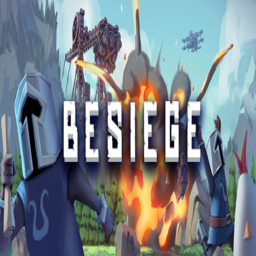

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 233450, title: Prison Architect, Score: 0.7773722410202026
선택된 게임의 content: Only the world’s most ruthless Warden can contain the world’s most ruthless inmates. Design and develop your personalized penitentiary in Prison Architect.
선택된 게임의 genres: ['Simulation', 'Building', 'Sandbox', 'Strategy', 'Base Building', 'Colony Sim', 'Management', 'City Builder', '2D', 'Top-Down', 'Economy', 'Resource Management', 'Capitalism', 'Funny', 'Moddable', 'Singleplayer', 'Multiplayer', 'Replay Value', 'Indie', 'Casual']


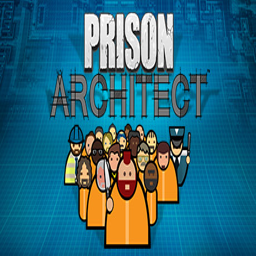

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 236850, title: Europa Universalis IV, Score: 0.7757821679115295
선택된 게임의 content: Four centuries of detailed history come alive in Paradox’s classic grand strategy game. Lead any nation from Renaissance to Revolution in a complex simulation of the early modern world. Master the art of war, diplomacy and trade to shape and change your nation’s history!
선택된 게임의 genres: ['Grand Strategy', 'Historical', 'Simulation', 'Alternate History', 'Economy', 'Military', 'Sandbox', 'Political', 'Diplomacy', 'Strategy', 'Real-Time with Pause', 'Nonlinear', 'Moddable', 'Replay Value', 'Management', 'Singleplayer', 'Multiplayer', 'Resource Management', 'Great Soundtrack', 'Education']


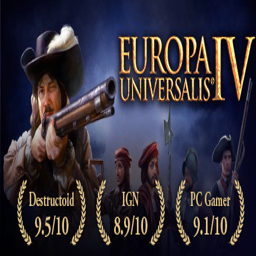

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 227300, title: Euro Truck Simulator 2, Score: 0.7671255469322205
선택된 게임의 content: Travel across Europe as king of the road, a trucker who delivers important cargo across impressive distances! With dozens of cities to explore, your endurance, skill and speed will all be pushed to their limits.
선택된 게임의 genres: ['Simulation', 'Driving', 'Automobile Sim', 'Open World', 'Realistic', 'Relaxing', 'Singleplayer', 'Moddable', 'Exploration', 'First-Person', 'Economy', 'Atmospheric', 'Adventure', 'Indie', 'Management', 'Casual', 'TrackIR', 'Sandbox', 'Racing', 'RPG']


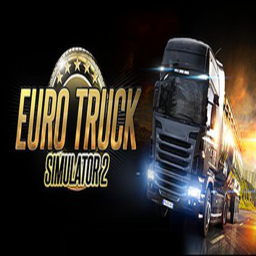

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 220200, title: Kerbal Space Program, Score: 0.760718047618866
선택된 게임의 content: In Kerbal Space Program, take charge of the space program for the alien race known as the Kerbals. You have access to an array of parts to assemble fully-functional spacecraft that flies (or doesn’t) based on realistic aerodynamic and orbital physics.
선택된 게임의 genres: ['Space', 'Simulation', 'Sandbox', 'Physics', 'Science', 'Space Sim', 'Building', 'Moddable', 'Indie', 'Education', 'Open World', 'Singleplayer', 'Exploration', 'Funny', 'Sci-fi', 'Difficult', 'Adventure', 'Strategy', 'Replay Value', 'Comedy']


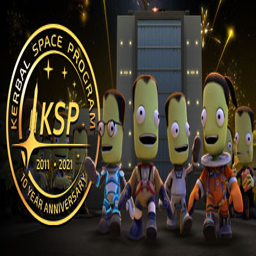

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 107410, title: Arma 3, Score: 0.7585098743438721
선택된 게임의 content: Experience true combat gameplay in a massive military sandbox. Deploying a wide variety of single- and multiplayer content, over 20 vehicles and 40 weapons, and limitless opportunities for content creation, this is the PC’s premier military game. Authentic, diverse, open - Arma 3 sends you to war.
선택된 게임의 genres: ['Action', 'Multiplayer', 'Military', 'Simulation', 'Shooter', 'First-Person', 'Realistic', 'Open World', 'Tactical', 'FPS', 'War', 'Co-op', 'Strategy', 'Sandbox', 'Moddable', 'Combat', 'Online Co-Op', 'Singleplayer', 'Team-Based', 'Third-Person Shooter']


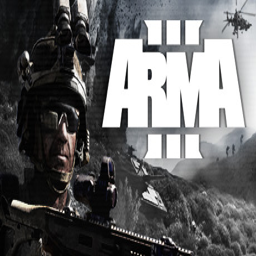

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 244850, title: Space Engineers, Score: 0.7572614550590515
선택된 게임의 content: Space Engineers is a sandbox game about engineering, construction, exploration and survival in space and on planets. Players build space ships, space stations, planetary outposts of various sizes and uses, pilot ships and travel through space to explore planets and gather resources to survive.
선택된 게임의 genres: ['Space', 'Sandbox', 'Building', 'Multiplayer', 'Open World Survival Craft', 'Simulation', 'Survival', 'Open World', 'Physics', 'Crafting', 'Destruction', 'Co-op', 'Indie', 'Futuristic', 'Sci-fi', 'Singleplayer', 'Action', 'Strategy', 'Adventure', 'Early Access']


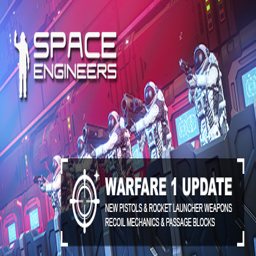

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 8930, title: Sid Meier's Civilization® V, Score: 0.7540625333786011
선택된 게임의 content: Create, discover, and download new player-created maps, scenarios, interfaces, and more!
선택된 게임의 genres: ['Turn-Based Strategy', 'Strategy', 'Turn-Based', 'Multiplayer', 'Historical', '4X', 'Addictive', 'Singleplayer', 'Hex Grid', 'Grand Strategy', 'Replay Value', 'Co-op', 'Tactical', 'Economy', 'Diplomacy', 'Moddable', 'Simulation', 'Classic', 'Great Soundtrack', 'Touch-Friendly']


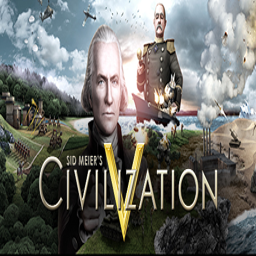

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 305620, title: The Long Dark, Score: 0.7517845630645752
선택된 게임의 content: The Long Dark is a thoughtful, exploration-survival experience that challenges solo players to think for themselves as they explore an expansive frozen wilderness in the aftermath of a geomagnetic disaster. There are no zombies -- only you, the cold, and all the threats Mother Nature can muster. Welcome to the Quiet Apocalypse.
선택된 게임의 genres: ['Open World Survival Craft', 'Survival', 'Open World', 'Exploration', 'Atmospheric', 'First-Person', 'Singleplayer', 'Adventure', 'Crafting', 'Sandbox', 'Simulation', 'Post-apocalyptic', 'Indie', 'Walking Simulator', 'Survival Horror', 'Strategy', 'Action', 'Difficult', 'Early Access', 'Horror']


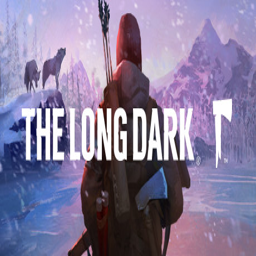

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 359320, title: Elite Dangerous, Score: 0.7476261854171753
선택된 게임의 content: Take control of your own starship in a cutthroat galaxy. Elite Dangerous is the definitive massively multiplayer space epic.
선택된 게임의 genres: ['Space Sim', 'Space', 'Open World', 'Exploration', 'Sci-fi', 'Simulation', 'Massively Multiplayer', 'Multiplayer', 'First-Person', 'Action', 'Adventure', 'Sandbox', 'VR', 'Online Co-Op', 'Trading', 'Singleplayer', 'RPG', 'Difficult', 'Strategy', 'TrackIR']


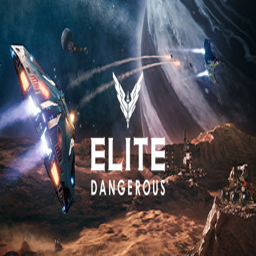

----------------------------------------------------------------------------------------------------


In [ ]:
# Cities: Skylines
get_sim_game(loaded_model, '255710')

## Sid Meier's Civilization® V

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 8930, 선택된 게임의 title: Sid Meier's Civilization® V
선택된 게임의 content: Create, discover, and download new player-created maps, scenarios, interfaces, and more!
선택된 게임의 genres: ['Turn-Based Strategy', 'Strategy', 'Turn-Based', 'Multiplayer', 'Historical', '4X', 'Addictive', 'Singleplayer', 'Hex Grid', 'Grand Strategy', 'Replay Value', 'Co-op', 'Tactical', 'Economy', 'Diplomacy', 'Moddable', 'Simulation', 'Classic', 'Great Soundtrack', 'Touch-Friendly']


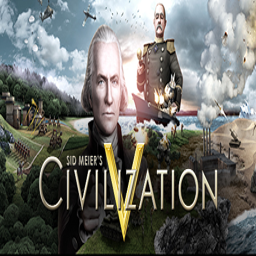

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 236850, title: Europa Universalis IV, Score: 0.8037787079811096
선택된 게임의 content: Four centuries of detailed history come alive in Paradox’s classic grand strategy game. Lead any nation from Renaissance to Revolution in a complex simulation of the early modern world. Master the art of war, diplomacy and trade to shape and change your nation’s history!
선택된 게임의 genres: ['Grand Strategy', 'Historical', 'Simulation', 'Alternate History', 'Economy', 'Military', 'Sandbox', 'Political', 'Diplomacy', 'Strategy', 'Real-Time with Pause', 'Nonlinear', 'Moddable', 'Replay Value', 'Management', 'Singleplayer', 'Multiplayer', 'Resource Management', 'Great Soundtrack', 'Education']


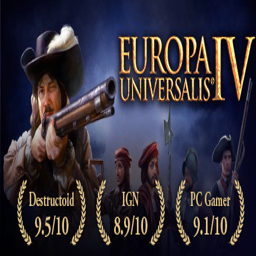

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 48700, title: Mount & Blade: Warband, Score: 0.7996092438697815
선택된 게임의 content: In a land torn asunder by incessant warfare, it is time to assemble your own band of hardened warriors and enter the fray. Lead your men into battle, expand your realm, and claim the ultimate prize: the throne of Calradia!
선택된 게임의 genres: ['Medieval', 'RPG', 'Open World', 'Strategy', 'Sandbox', 'Action', 'Multiplayer', 'Moddable', 'Military', 'Adventure', 'Horses', 'Singleplayer', 'Realistic', 'First-Person', 'Historical', 'Third Person', 'Simulation', 'Hack and Slash', 'Fantasy', 'Indie']


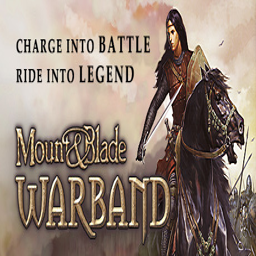

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 244850, title: Space Engineers, Score: 0.7880983352661133
선택된 게임의 content: Space Engineers is a sandbox game about engineering, construction, exploration and survival in space and on planets. Players build space ships, space stations, planetary outposts of various sizes and uses, pilot ships and travel through space to explore planets and gather resources to survive.
선택된 게임의 genres: ['Space', 'Sandbox', 'Building', 'Multiplayer', 'Open World Survival Craft', 'Simulation', 'Survival', 'Open World', 'Physics', 'Crafting', 'Destruction', 'Co-op', 'Indie', 'Futuristic', 'Sci-fi', 'Singleplayer', 'Action', 'Strategy', 'Adventure', 'Early Access']


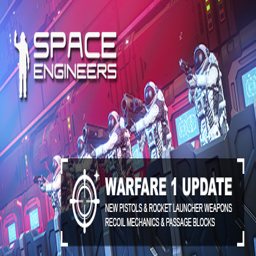

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 242920, title: Banished, Score: 0.7812667489051819
선택된 게임의 content: In this city-building strategy game, you control a group of exiled travelers who decide to restart their lives in a new land. They have only the clothes on their backs and a cart filled with supplies from their homeland. The townspeople of Banished are your primary resource.
선택된 게임의 genres: ['City Builder', 'Colony Sim', 'Strategy', 'Simulation', 'Survival', 'Indie', 'Singleplayer', 'Sandbox', 'Medieval', 'Relaxing', 'Resource Management', 'Economy', 'Building', 'Management', 'Open World', 'Difficult', 'Beautiful', 'Procedural Generation', 'Historical', 'RTS']


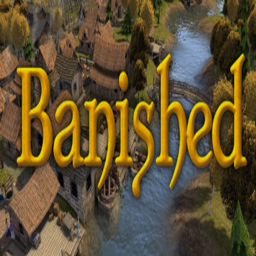

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 221380, title: Age of Empires II (2013), Score: 0.7797518968582153
선택된 게임의 content: Age of Empires II has been re-imagined in high definition with new features, trading cards, improved AI, workshop support, multiplayer, Steamworks integration and more!
선택된 게임의 genres: ['Strategy', 'RTS', 'Medieval', 'Multiplayer', 'Classic', 'Historical', 'Base Building', 'City Builder', 'Resource Management', 'Singleplayer', 'Tactical', 'Real-Time', 'Co-op', 'Competitive', 'Replay Value', 'Remake', '2D', 'Isometric', 'Action', 'Adventure']


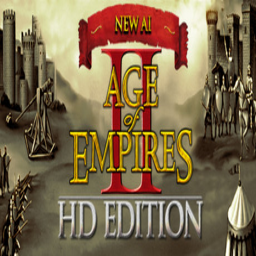

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 239820, title: Game Dev Tycoon, Score: 0.7762638330459595
선택된 게임의 content: In Game Dev Tycoon you replay the history of the gaming industry by starting your own video game development company in the 80s. Create best selling games. Research new technologies and invent new game types. Become the leader of the market and gain worldwide fans.
선택된 게임의 genres: ['Simulation', 'Management', 'Indie', 'Strategy', 'Casual', 'Singleplayer', 'Economy', '2D', 'Moddable', 'Addictive', 'Replay Value', 'Sandbox', 'GameMaker', 'Funny', 'Difficult', 'Point & Click', 'Great Soundtrack', 'Comedy', 'Touch-Friendly', 'Isometric']


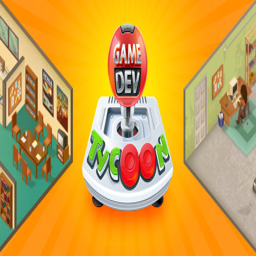

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 220200, title: Kerbal Space Program, Score: 0.7762570977210999
선택된 게임의 content: In Kerbal Space Program, take charge of the space program for the alien race known as the Kerbals. You have access to an array of parts to assemble fully-functional spacecraft that flies (or doesn’t) based on realistic aerodynamic and orbital physics.
선택된 게임의 genres: ['Space', 'Simulation', 'Sandbox', 'Physics', 'Science', 'Space Sim', 'Building', 'Moddable', 'Indie', 'Education', 'Open World', 'Singleplayer', 'Exploration', 'Funny', 'Sci-fi', 'Difficult', 'Adventure', 'Strategy', 'Replay Value', 'Comedy']


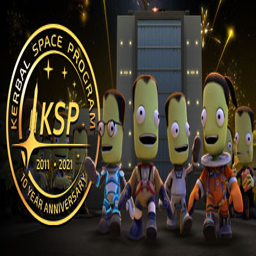

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 72850, title: The Elder Scrolls V: Skyrim, Score: 0.774499773979187
선택된 게임의 content: EPIC FANTASY REBORN The next chapter in the highly anticipated Elder Scrolls saga arrives from the makers of the 2006 and 2008 Games of the Year, Bethesda Game Studios. Skyrim reimagines and revolutionizes the open-world fantasy epic, bringing to life a complete virtual world open for you to explore any way you choose.
선택된 게임의 genres: ['Open World', 'RPG', 'Fantasy', 'Adventure', 'Moddable', 'Dragons', 'First-Person', 'Action', 'Medieval', 'Singleplayer', 'Magic', 'Story Rich', 'Great Soundtrack', 'Sandbox', 'Lore-Rich', 'Atmospheric', 'Character Customization', 'Action RPG', 'Third Person', 'Epic']


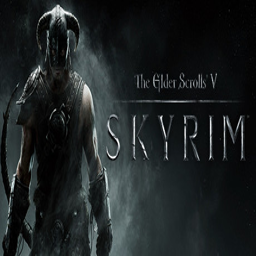

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 233450, title: Prison Architect, Score: 0.7694135904312134
선택된 게임의 content: Only the world’s most ruthless Warden can contain the world’s most ruthless inmates. Design and develop your personalized penitentiary in Prison Architect.
선택된 게임의 genres: ['Simulation', 'Building', 'Sandbox', 'Strategy', 'Base Building', 'Colony Sim', 'Management', 'City Builder', '2D', 'Top-Down', 'Economy', 'Resource Management', 'Capitalism', 'Funny', 'Moddable', 'Singleplayer', 'Multiplayer', 'Replay Value', 'Indie', 'Casual']


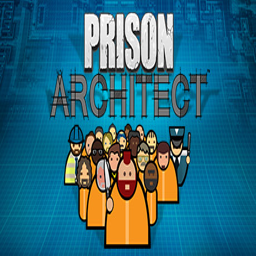

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 248820, title: Risk of Rain, Score: 0.7664167881011963
선택된 게임의 content: Risk of Rain is an action platformer with roguelike elements. With permanent death as a primary feature, players will have to play their best to get as far as possible. Fight on a mysterious planet with randomly spawning enemies and bosses, either alone or with 3 friends in online co-op.
선택된 게임의 genres: ['Action Roguelike', 'Roguelike', 'Indie', 'Platformer', 'Action', 'Pixel Graphics', 'Great Soundtrack', 'Online Co-Op', 'Difficult', 'Perma Death', 'Co-op', '2D', 'Local Co-Op', 'Roguelite', 'Multiplayer', 'RPG', 'Singleplayer', 'Addictive', 'Replay Value', 'Survival']


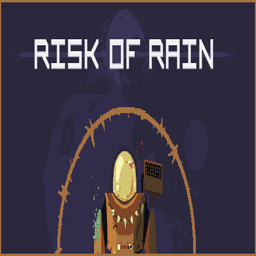

----------------------------------------------------------------------------------------------------


In [ ]:
# Sid Meier's Civilization® V
get_sim_game(loaded_model, '8930')

## Puyo Puyo™Tetris®

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 546050, 선택된 게임의 title: Puyo Puyo™Tetris®
선택된 게임의 content: Two puzzle game juggernauts collide as global phenomenon Tetris® and SEGA’s famous Puyo Puyo™ combine in a super mash-up of ferocious competition, adorable looks, and addictive puzzle fun!
선택된 게임의 genres: ['Puzzle', 'Casual', 'Competitive', 'Multiplayer', 'Action', 'Cute', 'Anime', 'Colorful', 'Local Multiplayer', 'Great Soundtrack', 'Arcade', '2D', 'Classic', '4 Player Local', 'Difficult', 'Female Protagonist', 'Funny', 'Singleplayer', 'Fighting', '2D Fighter']


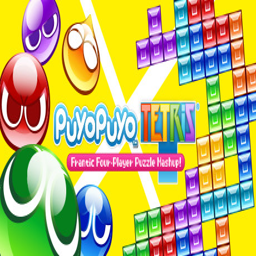

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 574980, title: Them's Fightin' Herds, Score: 0.7358858585357666
선택된 게임의 content: Them’s Fightin’ Herds is an indie fighting game featuring a cast of adorable animals designed by acclaimed cartoon producer Lauren Faust. Beneath the cute and cuddly surface, a serious fighter awaits!
선택된 게임의 genres: ['Action', '2D Fighter', 'Indie', 'Cute', 'Fighting', 'Cartoon', 'Multiplayer', 'Local Multiplayer', 'Singleplayer', 'PvP', 'Female Protagonist', 'Pixel Graphics', 'Anime', 'Colorful', 'Fantasy', 'Tutorial', 'Magic', 'Funny', 'Memes', 'Horses']


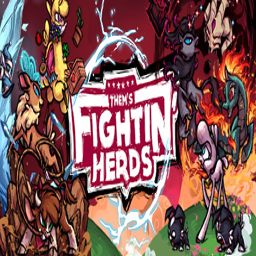

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 702890, title: BlazBlue: Cross Tag Battle, Score: 0.7233539819717407
선택된 게임의 content: THE COLLISION IS INEVITABLE! THE IMPACT WILL BE UNAVOIDABLE! Cross over between 4 different universes! Play as characters from the BlazBlue, Persona, Under Night In-Birth, and (for the first time ever in a fighting game), RWBY series!
선택된 게임의 genres: ['2D Fighter', 'Action', 'Anime', 'Fighting', 'Great Soundtrack', 'eSports', 'Local Multiplayer', 'Controller', 'Multiplayer', 'Singleplayer', 'Cute', 'Story Rich', 'Pixel Graphics', 'Tutorial', 'Competitive']


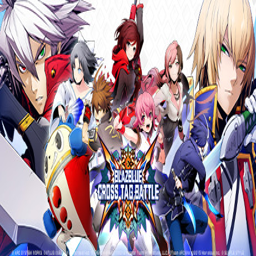

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 357190, title: ULTIMATE MARVEL VS. CAPCOM 3, Score: 0.7170807719230652
선택된 게임의 content: Marvel and Capcom join forces to deliver the most frenetic 3 vs 3 tag battles ever with Ultimate Marvel VS Capcom 3. This release comes fully loaded, including all previous DLC, Marvel VS. Capcom : Official Complete Works.
선택된 게임의 genres: ['Fighting', 'Action', '2D Fighter', 'Multiplayer', 'Superhero', 'Arcade', 'Comic Book', 'Competitive', 'Great Soundtrack', '2.5D', 'Local Multiplayer', 'Anime', "Beat 'em up", 'Singleplayer', 'Open World']


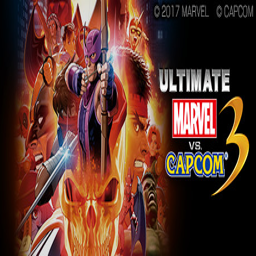

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1198510, title: Paperball, Score: 0.7158660888671875
선택된 게임의 content: It's time to get rolling! Navigate tricky passages, pull off crazy stunts and get ready to fall off a lot! Play carefully or risk it all for the fastest time - play any way you want in over 150 all unique stages.
선택된 게임의 genres: ['Action', 'Indie', 'Arcade', 'Time Attack', 'Racing', 'Platformer']


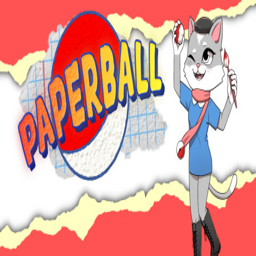

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 383980, title: Rivals of Aether, Score: 0.7145461440086365
선택된 게임의 content: RIVALS OF AETHER is an indie fighting game where warring civilizations summon the power of Fire, Water, Air, and Earth. Play with up to four players either locally or online.
선택된 게임의 genres: ['Fighting', '2D Fighter', 'Pixel Graphics', 'Multiplayer', 'Indie', 'Local Multiplayer', 'Competitive', 'Great Soundtrack', '2D', '4 Player Local', 'Platformer', 'Action', 'Games Workshop', 'Controller', 'Arcade', "Beat 'em up", 'Singleplayer', 'Early Access', 'Retro', 'GameMaker']


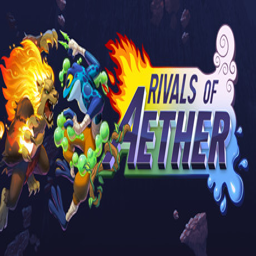

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 502800, title: SENRAN KAGURA ESTIVAL VERSUS, Score: 0.7096176743507385
선택된 게임의 content: Thrust into a parallel dimension, our buxom shinobi prepare for a new kind of beach-side battle. Can the islands’ hosts be trusted? Will the other schools play fair? Will there be time to enjoy the beach before the fighting starts? Will anyone manage to keep their clothes intact?
선택된 게임의 genres: ['Nudity', 'Sexual Content', 'Anime', '3D Fighter', 'Mature', 'Action', 'Female Protagonist', 'Hack and Slash', 'Cute', 'Fighting', 'Ninja', 'Multiplayer', 'Singleplayer', "Beat 'em up", 'Story Rich', 'Great Soundtrack', 'JRPG', 'Dating Sim', 'Visual Novel', 'Hentai']


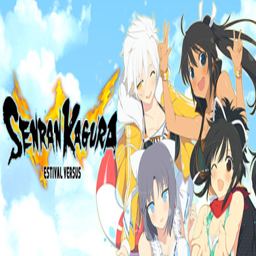

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 1026840, title: Ultra Fight Da ! Kyanta 2, Score: 0.7087684273719788
선택된 게임의 content: Ultra Fight Kyanta 2 is a fighting game with a frantic pace and easy to learn controls. You can perform special attacks using single button presses! Fight in 2D battles across various modes using teams of hand-drawn characters.
선택된 게임의 genres: ['Free to Play', 'Indie', 'Action', 'Fighting', 'Early Access', '2D Fighter', 'Competitive', 'Demons', 'Multiplayer', 'Anime']


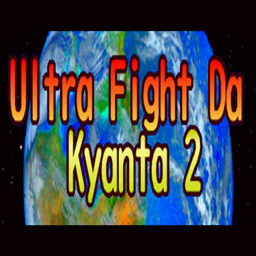

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 565170, title: Blade Strangers, Score: 0.7060330510139465
선택된 게임의 content: A malevolent force known only as Lina is devouring data from a vast, interdimensional network of servers overseen by sentient computers called ”motes.” In desperation, the motes summon heroes from a variety of parallel game worlds to face off against each other in one-on-one combat.
선택된 게임의 genres: ['Action', 'Fighting', '2D Fighter', 'Anime']


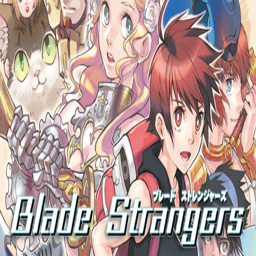

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 716710, title: 東方憑依華　～ Antinomy of Common Flowers., Score: 0.7047690749168396
선택된 게임의 content: 今度の異変は二人で一人？ いまだ煽り続ける都市伝説が新たな異変を引き起こす 今度の異変は二人が一人！？ならば二人で解決するしかない！
선택된 게임의 genres: ['Great Soundtrack', 'Fighting', '2D Fighter', 'Faith', 'Female Protagonist', 'Indie', 'Bullet Hell', 'Action', 'Anime', 'Cute', 'Lore-Rich', 'Fantasy', '2D', 'Story Rich', 'Arcade', 'Difficult', 'Singleplayer', 'Multiplayer', 'Memes', 'Family Friendly']


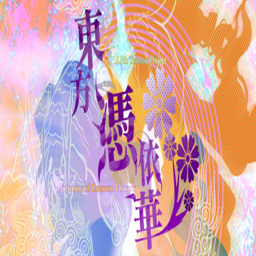

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 724300, title: Roof Rage, Score: 0.7037141919136047
선택된 게임의 content: Roof Rage is a Martial Arts Platform Fighter featuring epic rooftop battles. Play with up to 8 players locally or 1vs1 online.
선택된 게임의 genres: ['Indie', 'Action', 'Fighting', '2D Fighter', 'Pixel Graphics', 'Multiplayer', '2D', 'Retro', 'Local Multiplayer', 'Arcade', 'Early Access', 'Martial Arts']


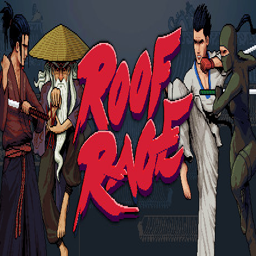

----------------------------------------------------------------------------------------------------


In [ ]:
# Puyo Puyo™Tetris®
get_sim_game(loaded_model, '546050')

# 배틀이라는 기준에서 본다면 충분히 추천이 잘되었다고 볼 수 있다함

## DJMAX RESPECT V

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 960170, 선택된 게임의 title: DJMAX RESPECT V
선택된 게임의 content: DJMAX RESPECT V is the latest installment from the creators of the critically acclaimed rhythm game franchise ‘DJMAX.’ Experience tracks from popular artists such as Marshmello, Porter Robinson, and Yukika, exclusive Full HD Music Videos, online multiplayer, new game modes, and more!
선택된 게임의 genres: ['Casual', 'Rhythm', 'Action', 'Sports', 'Music', 'Great Soundtrack', 'Anime', 'Multiplayer', 'Early Access', 'Singleplayer', 'Competitive', 'Difficult', 'Arcade']


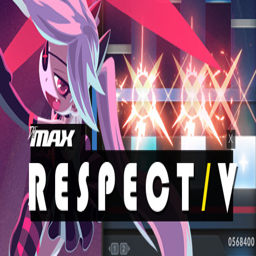

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1004770, title: Maiden and Spell, Score: 0.7458212971687317
선택된 게임의 content: Maiden & Spell is a magical girl battle game, set in a cutesy fantasy world. Select from one of eight young ladies to battle 1 on 1 with a friend, or fight your way through a series of bosses and learn the secrets of The Kingdom of Stars.
선택된 게임의 genres: ['Action', 'Indie', 'Bullet Hell', 'Cute', 'Female Protagonist', 'Fighting', 'Anime', 'Multiplayer', "Shoot 'Em Up", '2D', 'Local Multiplayer', 'Difficult', 'PvP', '2D Fighter', 'Arcade', 'Fantasy', 'Colorful', 'Fast-Paced', '2.5D', 'Short']


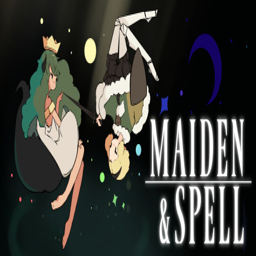

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 960690, title: One Step From Eden, Score: 0.716343343257904
선택된 게임의 content: Build a powerful deck, cast spells on the fly, battle evolving enemies, find game-changing artifacts, make friends or make enemies, just make it to Eden.
선택된 게임의 genres: ['Action Roguelike', 'Roguelite', 'Card Battler', 'Difficult', 'Action', 'Deckbuilding', 'Replay Value', 'Adventure', 'Action RPG', 'Strategy', 'Card Game', 'Roguelike', 'Bullet Hell', 'Indie', 'Pixel Graphics', 'Hack and Slash', 'Local Co-Op', 'Anime', '2D', 'Female Protagonist']


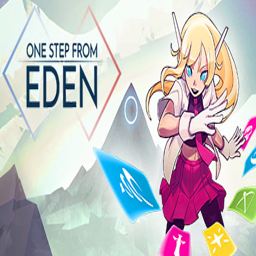

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 939600, title: LOVE³ -Love Cube-, Score: 0.7094414830207825
선택된 게임의 content: Things are about to change for Ichinari Tsuzurigi, an adult comics artist living in poverty. Blessed by his "Fates", he is facing a turning point of his career, and three women are going to live together with him...
선택된 게임의 genres: ['Sexual Content', 'Nudity', 'Hentai', 'Visual Novel', 'Anime', 'Mature', 'Indie', 'Casual', 'Romance', 'NSFW', 'Adventure', 'Dating Sim']


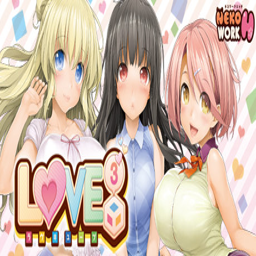

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1189800, title: Bleeding Edge, Score: 0.7091874480247498
선택된 게임의 content: Grab your team and tear it up in Bleeding Edge, an electrifying online brawler where every fighter comes mechanically enhanced for mayhem!
선택된 게임의 genres: ['Action', 'Multiplayer', 'Team-Based', 'Third Person', 'Fighting', 'Competitive', 'PvP', 'MOBA', 'Cyberpunk', 'Hero Shooter', 'Hack and Slash', 'Online Co-Op']


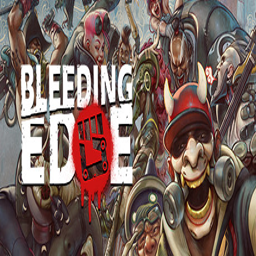

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 728530, title: SD GUNDAM G GENERATION CROSS RAYS, Score: 0.7086629271507263
선택된 게임의 content: Beyond creation, four eras come together as one! Discover the latest entry in this iconic Tactical RPG series. Form your own team of SD Gundams and deploy for battle -- with units from Mobile Suit Gundam Wing, SEED, 00, and Iron-Blooded Orphans!
선택된 게임의 genres: ['Tactical RPG', 'Mechs', 'Turn-Based Tactics', 'Cinematic', 'RPG', 'JRPG', 'Anime', 'Character Customization', 'Robots', 'Turn-Based', 'Singleplayer', 'Turn-Based Strategy', 'Strategy RPG', 'Isometric', 'Top-Down', '2.5D', 'Sci-fi', 'Space', 'Story Rich', 'Strategy']


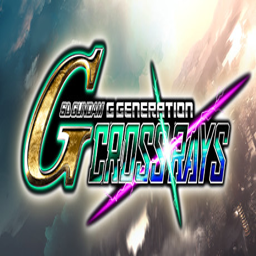

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 913060, title: Jet Lancer, Score: 0.7076769471168518
선택된 게임의 content: Jet Lancer is a high-velocity aerial combat shooter where you duel enemy aviators, hunt giant robots, and defy death at supersonic speeds as you evolve from an unknown rookie aviator into a once-in-a-generation ACE pilot.
선택된 게임의 genres: ['Action', 'Indie', 'Bullet Hell', 'Pixel Graphics', "Shoot 'Em Up", 'Great Soundtrack', 'Fast-Paced', 'Difficult', 'Arcade', '2D', 'Singleplayer', 'Sci-fi', 'Replay Value', 'Female Protagonist', 'Shooter', 'Flight', 'Addictive', 'Anime', 'Retro', 'Twin Stick Shooter']


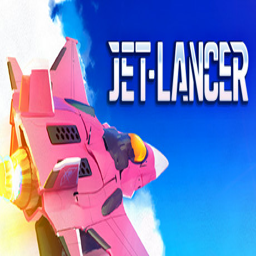

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 921430, title: Genius! NAZI-GIRL GoePPels-Chan ep1, Score: 0.7050721645355225
선택된 게임의 content: This is a slightly different history to the world we know. Having been appointed propaganda minister at the age of 14, the genius girl. Geri Goeppels, together with her private secretaries Rolly and Flute, is up to all sorts of secret maneuvers.
선택된 게임의 genres: ['Casual', 'Indie', 'Visual Novel', 'Anime']


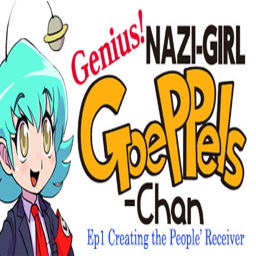

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 728880, title: Overcooked! 2, Score: 0.6989453434944153
선택된 게임의 content: Overcooked returns with a brand-new helping of chaotic cooking action! Journey back to the Onion Kingdom and assemble your team of chefs in classic couch co-op or online play for up to four players. Hold onto your aprons… it’s time to save the world again!
선택된 게임의 genres: ['Multiplayer', 'Online Co-Op', 'Local Co-Op', 'Co-op', 'Casual', 'Funny', 'Indie', 'Action', '4 Player Local', 'Local Multiplayer', 'Family Friendly', 'Controller', 'Cute', 'Comedy', 'Singleplayer', 'Cooking', 'Difficult', 'Simulation', 'Colorful', 'Strategy']


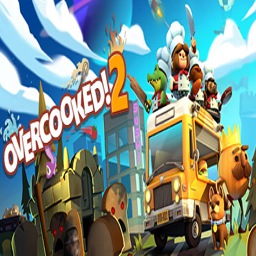

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 1034940, title: Higurashi When They Cry Hou - Ch.7 Minagoroshi, Score: 0.6974544525146484
선택된 게임의 content: Higurashi When They Cry is a sound novel. The music, backgrounds and characters work together to create a world that is the stage of a novel for the user to read. They laugh and cry and get angry. The user takes the point of view of the protagonist to experience the story.
선택된 게임의 genres: ['Adventure', 'Visual Novel', 'Anime', 'Horror', 'Mystery', 'Psychological Horror', 'Story Rich', 'Indie', '2D', 'Dark', 'Singleplayer', 'Atmospheric', 'Great Soundtrack']


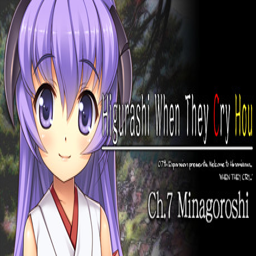

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 1043240, title: Touhou Kishinjou ~ Double Dealing Character., Score: 0.6961830258369446
선택된 게임의 content: 飛び出そう、いつも通りの弾幕へ それが結果として世界をひっくり返す事になるだろう プリティでデュアリスチックなシューティング幻想！
선택된 게임의 genres: ['Indie', 'Bullet Hell', 'Action', "Shoot 'Em Up", 'Great Soundtrack', 'Difficult', 'Faith', 'Female Protagonist', 'Singleplayer', 'Anime', '2D', 'Arcade']


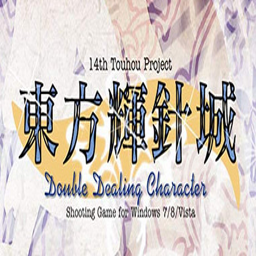

----------------------------------------------------------------------------------------------------


In [ ]:
# DJMAX RESPECT V
get_sim_game(loaded_model, '960170')

# 8번째 추천 게임을 해봤다고 했지만 전체적인 취향이 자신과 비슷하다고 하지는 않음

## Monster Hunter: World

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 582010, 선택된 게임의 title: Monster Hunter: World
선택된 게임의 content: Welcome to a new world! In Monster Hunter: World, the latest installment in the series, you can enjoy the ultimate hunting experience, using everything at your disposal to hunt monsters in a new world teeming with surprises and excitement.
선택된 게임의 genres: ['Co-op', 'Multiplayer', 'Action', 'Open World', 'RPG', 'Third Person', 'Character Customization', 'Adventure', 'Fantasy', 'Difficult', 'Singleplayer', 'Action RPG', 'Exploration', 'Great Soundtrack', 'Replay Value', 'Atmospheric', 'Hack and Slash', 'JRPG', 'Souls-like', 'MMORPG']


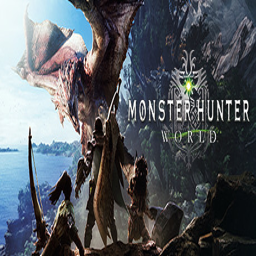

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 589360, title: Ni no Kuni™ II: Revenant Kingdom, Score: 0.7694352269172668
선택된 게임의 content: Join the young king Evan as he sets out on an epic quest to found a new kingdom and, with the help of some new friends, unite his world, saving its people from a terrible evil.
선택된 게임의 genres: ['RPG', 'JRPG', 'Anime', 'Adventure', 'Open World', 'Singleplayer', 'Fantasy', 'Story Rich', 'Cute', 'Action RPG', 'Great Soundtrack', 'Hack and Slash', 'Dungeon Crawler', 'Action', 'Strategy', 'City Builder', 'Cartoony', 'Multiplayer', 'Exploration', 'Survival']


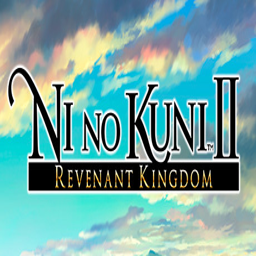

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 632360, title: Risk of Rain 2, Score: 0.7634727358818054
선택된 게임의 content: Escape a chaotic alien planet by fighting through hordes of frenzied monsters – with your friends, or on your own. Combine loot in surprising ways and master each character until you become the havoc you feared upon your first crash landing.
선택된 게임의 genres: ['Third-Person Shooter', 'Action Roguelike', 'Multiplayer', 'Action', 'Roguelite', 'Co-op', 'Looter Shooter', 'Roguelike', 'Loot', 'Shooter', 'Online Co-Op', 'Difficult', 'Survival', 'Third Person', 'Indie', 'Singleplayer', 'Soundtrack', 'Early Access', 'Great Soundtrack', 'Bullet Hell']


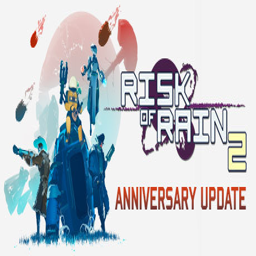

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 814380, title: Sekiro™: Shadows Die Twice - GOTY Edition, Score: 0.7601270079612732
선택된 게임의 content: Game of the Year - The Game Awards 2019 Best Action Game of 2019 - IGN Carve your own clever path to vengeance in the award winning adventure from developer FromSoftware, creators of Bloodborne and the Dark Souls series. Take Revenge. Restore Your Honor. Kill Ingeniously.
선택된 게임의 genres: ['Souls-like', 'Difficult', 'Action', 'Singleplayer', 'Ninja', 'Stealth', 'Adventure', 'Third Person', 'Open World', 'Story Rich', 'Atmospheric', 'Violent', 'Assassin', 'Dark Fantasy', 'Great Soundtrack', 'Hack and Slash', 'RPG', 'Gore', 'Dark', 'Rhythm']


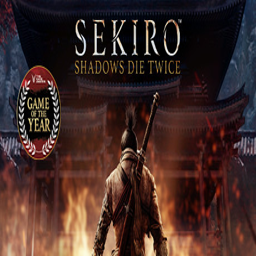

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 39210, title: FINAL FANTASY XIV Online, Score: 0.754256010055542
선택된 게임의 content: Take part in an epic and ever-changing FINAL FANTASY as you adventure and explore with friends from around the world.
선택된 게임의 genres: ['MMORPG', 'RPG', 'Massively Multiplayer', 'Fantasy', 'JRPG', 'Great Soundtrack', 'Character Customization', 'Open World', 'Story Rich', 'Anime', 'Multiplayer', 'Adventure', 'Magic', 'Action', 'Atmospheric', 'Co-op', 'Action RPG', 'Online Co-Op', 'Singleplayer', 'Female Protagonist']


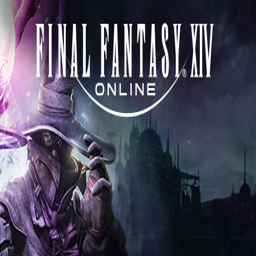

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 594650, title: Hunt: Showdown, Score: 0.7420210838317871
선택된 게임의 content: Hunt: Showdown is a thrilling, high-stakes PvPvE first-person shooter. Take down nightmarish monsters, as you compete for the bounties that will bring you glory, gear, and gold in this unforgiving – and unforgettable - online multiplayer experience.
선택된 게임의 genres: ['Multiplayer', 'Hunting', 'Online Co-Op', 'Horror', 'FPS', 'Shooter', 'Survival', 'PvP', 'Zombies', 'Western', 'Survival Horror', 'Open World', 'Action', 'First-Person', 'Perma Death', 'Team-Based', 'Violent', 'Gore', 'Battle Royale', 'Co-op']


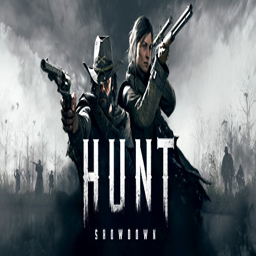

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 361420, title: ASTRONEER, Score: 0.7414434552192688
선택된 게임의 content: A game of aerospace industry and interplanetary exploration.
선택된 게임의 genres: ['Open World Survival Craft', 'Open World', 'Multiplayer', 'Space', 'Survival', 'Exploration', 'Base Building', 'Sandbox', 'Co-op', 'Adventure', 'Building', 'Crafting', 'Sci-fi', 'Simulation', 'Third Person', 'Colorful', 'Singleplayer', 'Automation', 'Atmospheric', 'Indie']


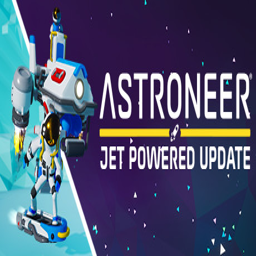

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 435150, title: Divinity: Original Sin 2 - Definitive Edition, Score: 0.7408353090286255
선택된 게임의 content: The critically acclaimed RPG that raised the bar, from the creators of Baldur's Gate 3. Gather your party. Master deep, tactical combat. Venture as a party of up to four - but know that only one of you will have the chance to become a God.
선택된 게임의 genres: ['Exploration', 'Tactical RPG', 'CRPG', 'Story Rich', 'PvP', 'Turn-Based Strategy', 'Fantasy', 'Strategy RPG', 'Party-Based RPG', 'RPG', 'Character Customization', 'Female Protagonist', 'Co-op Campaign', 'Local Co-Op', 'Romance', 'Funny', 'Strategy', 'Isometric', 'Moddable', '3D']


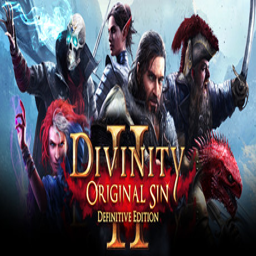

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 629760, title: MORDHAU, Score: 0.7384748458862305
선택된 게임의 content: MORDHAU is a multiplayer medieval slasher. Create your mercenary and fight in brutal battles where you will experience fast paced combat, castle sieges, cavalry charges, and more.
선택된 게임의 genres: ['Medieval', 'Multiplayer', 'First-Person', 'Swordplay', 'Online Co-Op', 'Gore', 'PvP', 'Action', 'Fighting', 'PvE', 'Team-Based', 'Character Customization', 'Third Person', 'Hack and Slash', 'Realistic', 'Competitive', 'Historical', 'FPS', 'Survival', 'Indie']


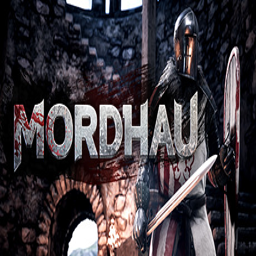

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 392110, title: ENDLESS™ Space 2, Score: 0.7362557053565979
선택된 게임의 content: Endless Space 2 is a Strategic Space Opera, featuring the compelling “just one more turn” gameplay, set in the mysterious Endless universe. As the leader of your civilization, will you impose your vision and build the greatest stellar empire?
선택된 게임의 genres: ['Strategy', 'Space', 'Sci-fi', '4X', 'Multiplayer', 'Turn-Based Strategy', 'Turn-Based', 'Grand Strategy', 'Great Soundtrack', 'Singleplayer', 'Action', 'Open World', 'War', 'Atmospheric', 'Co-op', 'Sandbox', 'Moddable', 'RTS', 'RPG', 'Indie']


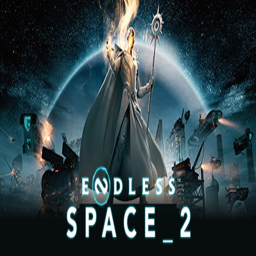

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 552500, title: Warhammer: Vermintide 2, Score: 0.7348400950431824
선택된 게임의 content: The critically acclaimed Vermintide 2 is a visually stunning and groundbreaking melee action game pushing the boundaries of the first person co-op genre. Join the fight now!
선택된 게임의 genres: ['Co-op', 'First-Person', 'Hack and Slash', 'Online Co-Op', 'Gore', 'Multiplayer', 'Dark Fantasy', 'Action', 'Violent', 'Fantasy', 'PvE', 'Games Workshop', 'Atmospheric', 'FPS', 'Action RPG', 'Singleplayer', 'Survival', 'Adventure', 'Indie', 'Warhammer 40K']


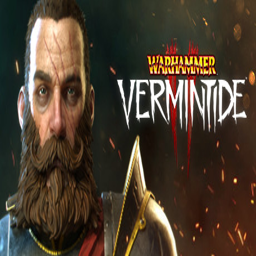

----------------------------------------------------------------------------------------------------


In [ ]:
# Monster Hunter: World
get_sim_game(loaded_model, '582010')

# 전체적인 추천된 게임의 스타일은 비슷하나 난이도가 어려워서 추천을 해준다면 자신은 하지 않는다고 함

## 프린세스 메이커

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 523000, 선택된 게임의 title: Princess Maker 2 Refine
선택된 게임의 content: Princess Maker 2 Refine is a life simulation game which you play as a father of a girl, who had descended from the star. You have 8 years to raise your daughter from age 10 to 18 – your daughter will grow into her adulthood through various experiences.
선택된 게임의 genres: ['Simulation', 'Multiple Endings', 'RPG', 'Female Protagonist', 'Anime', 'Singleplayer', 'Cute', 'Classic', 'Management', 'Retro', 'Life Sim', 'Choices Matter', 'Nudity', 'Fantasy', 'Great Soundtrack', 'Medieval', 'JRPG', 'Visual Novel', 'Cult Classic']


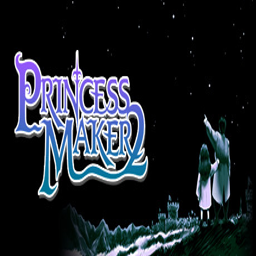

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 650110, title: Princess Maker 3: Fairy Tales Come True, Score: 0.7520658373832703
선택된 게임의 content: Princess Maker 3: Fairy Tales Come True to Steam on end of June 2017. This new release contains the original concept and feel to its series, but also had been upgraded to be compatible on Window 7 and above OS, and optimized to fit 16:9 aspect ratio. In addition to system upgrade, the game utilizes the Steam achievement system.
선택된 게임의 genres: ['Simulation', 'Anime', 'Classic', 'Multiple Endings']


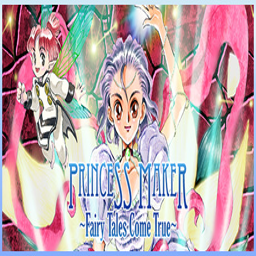

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 449250, title: A Little Lily Princess, Score: 0.7210720777511597
선택된 게임의 content: Newly arrived at a boarding school in Victorian England, Sara Crewe uses her love of books and storytelling to build new relationships. But what happens to a fairy-tale princess when she loses everything?
선택된 게임의 genres: ['Visual Novel', 'Female Protagonist', 'LGBTQ', 'Cute', 'Story Rich', 'Anime', 'Romance', 'Based On A Novel', 'Dating Sim', 'Multiple Endings', 'Drama', 'Emotional', 'Simulation', 'Singleplayer', '2D', 'Indie']


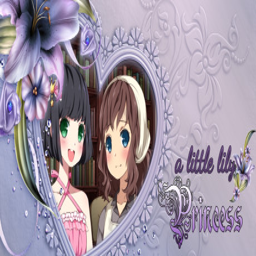

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 494450, title: Office lovers, Score: 0.7147346138954163
선택된 게임의 content: It's a romance game where you can experience the thrill of an office romance where you have to keep your relationship secret. What will happen when you're alone with him in the conference room?
선택된 게임의 genres: ['Adventure', 'Visual Novel', 'Otome']


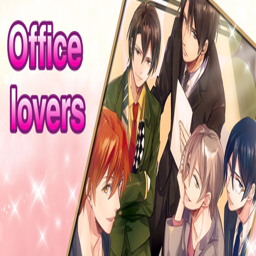

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 303290, title: OZMAFIA!!, Score: 0.7100738883018494
선택된 게임의 content: Once upon a time, a girl, her pet dog, and three companions made a journey to meet a great wizard who could grant their wishes. But what if the girl hadn’t believed that “there’s no place like home”? Explore a fairytale world through a dozen routes and 20+ endings!
선택된 게임의 genres: ['Otome', 'Visual Novel', 'Female Protagonist', 'Romance', 'Anime', 'Dating Sim', 'Adventure', 'Fantasy', 'Cute', 'Psychological Horror']


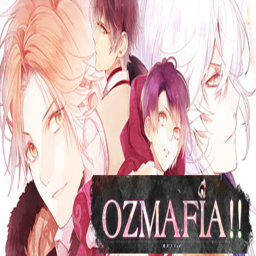

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 777130, title: Blush Blush, Score: 0.7072060704231262
선택된 게임의 content: You are responsible somehow for a curse that befalls 12 unfortunate hawt dudes. Now you have to find them and break the curse with your love!!
선택된 게임의 genres: ['Sexual Content', 'Free to Play', 'LGBTQ', 'Dating Sim', 'Nudity', 'Anime', 'Clicker', 'Romance', 'Casual', 'Cute', 'Otome', 'Simulation', 'Hentai', 'Funny', 'Indie', 'Singleplayer', 'Mature', 'Early Access', 'Visual Novel', 'Resource Management']


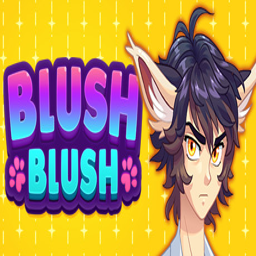

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 530360, title: Requiescence, Score: 0.7000908255577087
선택된 게임의 content: Dive into the story of Kymil, a young ice mage on a quest to unravel the mystery behind his uncle's death. As the world you know shatters around you, will you find a place for romance while the stakes climb higher?
선택된 게임의 genres: ['Casual', 'Visual Novel', 'LGBTQ', 'Romance']


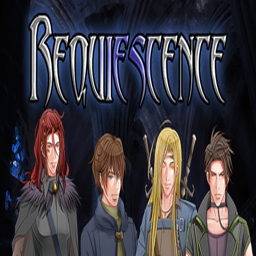

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 321290, title: Dandelion - Wishes brought to you -, Score: 0.6980968713760376
선택된 게임의 content: Dandelion -Wishes brought to you- is a female-oriented game developed by Cheritz. The game was released in South Korea in August, 2012. The English translation for Dandelion was released on Nov, 2012. Dandelion is known as a unique dating simulation with a sensational storyline and charming characters.
선택된 게임의 genres: ['Otome', 'Dating Sim', 'Visual Novel', 'Female Protagonist', 'Simulation', 'Anime', 'Romance', 'Story Rich', 'Singleplayer']


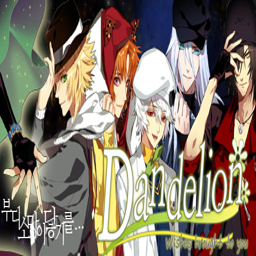

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 421630, title: A Study in Steampunk: Choice by Gaslight, Score: 0.6953945755958557
선택된 게임의 content: Steam-powered mechs meet forbidden sorcery in this interactive steampunk novel, inspired by Sherlock Holmes, Dracula, Jekyll & Hyde, and Jack the Ripper!
선택된 게임의 genres: ['Indie', 'RPG', 'Steampunk', 'Choose Your Own Adventure', 'Text-Based', 'Interactive Fiction']


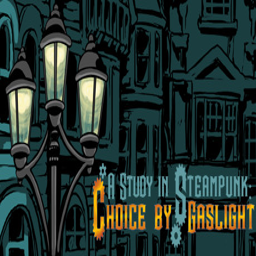

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 622060, title: XOXO Droplets, Score: 0.6950843930244446
선택된 게임의 content: An otome dating sim about a humorously jerky young lady and her mission to woo one of multiple uniquely, but equally, obnoxious guys.
선택된 게임의 genres: ['Simulation', 'Casual', 'Indie', 'Dating Sim', 'Visual Novel', 'Female Protagonist', 'Free to Play', 'Romance', 'Otome', 'Anime', 'Multiple Endings', 'Funny', 'Comedy', 'Crowdfunded', 'Singleplayer']


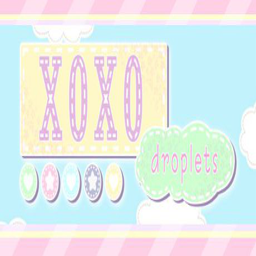

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 525700, title: Birthdays the Beginning, Score: 0.6947715878486633
선택된 게임의 content: The origins of the world are yours to decide in this engaging and open-ended builder experience! Shape the geography, control the temperature, and give rise to diverse lifeforms. Witness the birth of an entirely new ecosystem, made with your very own hands!
선택된 게임의 genres: ['Simulation', 'God Game', 'Sandbox', 'Dinosaurs', 'Singleplayer', 'Cute']


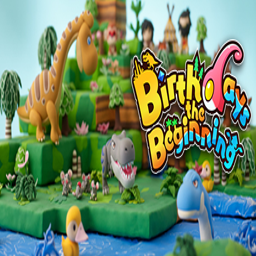

----------------------------------------------------------------------------------------------------


In [ ]:
# 프린세스 메이커
get_sim_game(loaded_model, '523000')

# 이거는 그래도 먼가 추천은 잘 된듯?

## 스카이림

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 489830, 선택된 게임의 title: The Elder Scrolls V: Skyrim Special Edition
선택된 게임의 content: Winner of more than 200 Game of the Year Awards, Skyrim Special Edition brings the epic fantasy to life in stunning detail. The Special Edition includes the critically acclaimed game and add-ons with all-new features like remastered art and effects, volumetric god rays, dynamic depth of field, screen-space reflections, and more.
선택된 게임의 genres: ['Open World', 'RPG', 'Adventure', 'Singleplayer', 'Fantasy', 'Character Customization', 'Dragons', 'Moddable', 'Story Rich', 'Magic', 'First-Person', 'Action', 'Atmospheric', 'Great Soundtrack', 'Third Person', 'Stealth', 'Classic', 'Remake', 'Female Protagonist', 'Walking Simulator']


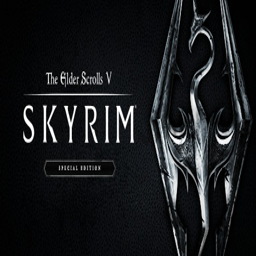

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 306130, title: The Elder Scrolls® Online, Score: 0.7605239152908325
선택된 게임의 content: Join over 18 million players in the award-winning online multiplayer RPG and experience limitless adventure in a persistent Elder Scrolls world. Battle, craft, steal, or explore, and combine different types of equipment and abilities to create your own style of play. No game subscription required.
선택된 게임의 genres: ['RPG', 'MMORPG', 'Open World', 'Massively Multiplayer', 'Multiplayer', 'Fantasy', 'Adventure', 'First-Person', 'Exploration', 'Story Rich', 'Third Person', 'Magic', 'Action', 'Co-op', 'Atmospheric', 'Great Soundtrack', 'Action RPG', 'Singleplayer', 'Sandbox', 'Character Customization']


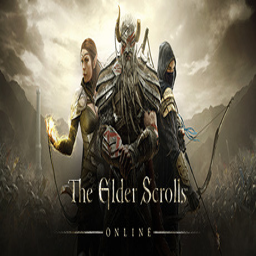

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 359550, title: Tom Clancy's Rainbow Six® Siege, Score: 0.7400144338607788
선택된 게임의 content: Tom Clancy's Rainbow Six Siege is the latest installment of the acclaimed first-person shooter franchise developed by the renowned Ubisoft Montreal studio.
선택된 게임의 genres: ['FPS', 'Hero Shooter', 'Multiplayer', 'Tactical', 'Shooter', 'Team-Based', 'Action', 'First-Person', 'Competitive', 'Co-op', 'Strategy', 'Realistic', 'Online Co-Op', 'Destruction', 'Psychological Horror', 'Physics', 'Atmospheric', 'Singleplayer', 'Massively Multiplayer', 'Casual']


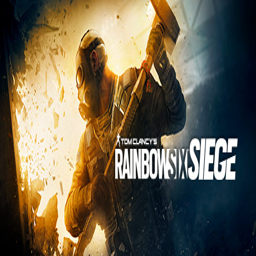

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 22320, title: The Elder Scrolls III: Morrowind® Game of the Year Edition, Score: 0.7390753626823425
선택된 게임의 content: The Elder Scrolls III: Morrowind® Game of the Year Edition includes Morrowind plus all of the content from the Bloodmoon and Tribunal expansions. The original Mod Construction Set is not included in this package. An epic, open-ended single-player RPG, Morrowind allows you to create and play any kind of character imaginable.
선택된 게임의 genres: ['RPG', 'Open World', 'Fantasy', 'Classic', 'Great Soundtrack', 'Moddable', 'Singleplayer', 'First-Person', 'Adventure', 'Cult Classic', 'Atmospheric', 'Magic', 'Exploration', 'Story Rich', 'Sandbox', 'Action RPG', 'Character Customization', 'Medieval', 'Action', 'Third Person']


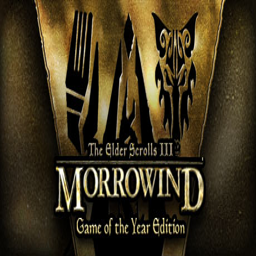

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 291860, title: Pit People®, Score: 0.737554132938385
선택된 게임의 content: In this fast-paced, turn-based, co-op adventure you'll quest and explore, find awesome loot, customize your fighters, and recruit strange species! Come master your destiny in this strategic game of positioning.
선택된 게임의 genres: ['Strategy', 'RPG', 'Funny', 'Turn-Based Combat', 'Action', 'Indie', 'Comedy', 'Turn-Based', 'Co-op', 'Multiplayer', 'Great Soundtrack', 'Memes', 'Local Co-Op', 'Hex Grid', 'Adventure', 'Open World', 'Singleplayer', 'Early Access', 'Gore', 'Casual']


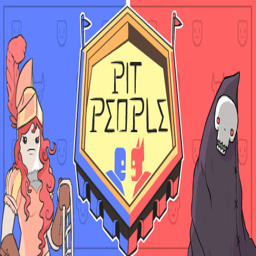

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 311210, title: Call of Duty®: Black Ops III, Score: 0.7355803847312927
선택된 게임의 content: Call of Duty®: Black Ops III Zombies Chronicles Edition includes the full base game plus the Zombies Chronicles content expansion.
선택된 게임의 genres: ['Multiplayer', 'FPS', 'Zombies', 'Shooter', 'Action', 'First-Person', 'Co-op', 'Singleplayer', 'Futuristic', 'Illuminati', 'Hero Shooter', 'Robots', 'Sci-fi', 'Gore', 'Great Soundtrack', 'Story Rich', 'Atmospheric', 'Quick-Time Events', 'Parkour', 'Simulation']


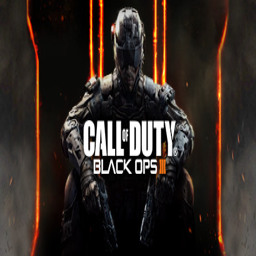

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 346110, title: ARK: Survival Evolved, Score: 0.7344839572906494
선택된 게임의 content: Stranded on the shores of a mysterious island, you must learn to survive. Use your cunning to kill or tame the primeval creatures roaming the land, and encounter other players to survive, dominate... and escape!
선택된 게임의 genres: ['Open World Survival Craft', 'Survival', 'Open World', 'Multiplayer', 'Dinosaurs', 'Crafting', 'Building', 'Adventure', 'Base Building', 'Co-op', 'Action', 'First-Person', 'Sandbox', 'Massively Multiplayer', 'Singleplayer', 'Early Access', 'RPG', 'Dragons', 'Sci-fi', 'Indie']


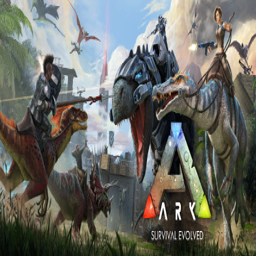

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 403640, title: Dishonored 2, Score: 0.7343090772628784
선택된 게임의 content: Reprise your role as a supernatural assassin in Dishonored 2. Declared a “masterpiece” by Eurogamer and hailed “a must-play revenge tale” by Game Informer, Dishonored 2 is the follow up to Arkane’s 1st-person action blockbuster & winner of 100+ 'Game of the Year' awards, Dishonored.
선택된 게임의 genres: ['Stealth', 'First-Person', 'Action', 'Assassin', 'Singleplayer', 'Steampunk', 'Atmospheric', 'Story Rich', 'Female Protagonist', 'Magic', 'Parkour', 'Supernatural', 'Open World', 'Adventure', 'Great Soundtrack', 'Exploration', 'Gore', 'Heist', 'Dystopian ', 'Immersive Sim']


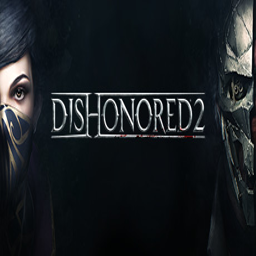

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 367500, title: Dragon's Dogma: Dark Arisen, Score: 0.7333540320396423
선택된 게임의 content: Set in a huge open world, Dragon’s Dogma: Dark Arisen presents a rewarding action combat experience.
선택된 게임의 genres: ['RPG', 'Open World', 'Character Customization', 'Action', 'Fantasy', 'Adventure', 'Singleplayer', 'Action RPG', 'Dragons', 'Third Person', 'Dark Fantasy', 'Magic', 'Exploration', 'Atmospheric', 'Great Soundtrack', 'Story Rich', 'Difficult', 'JRPG', 'Multiplayer', 'Hack and Slash']


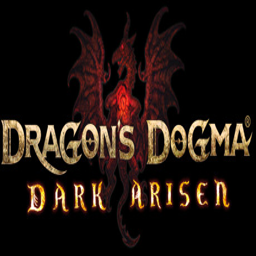

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 373420, title: Divinity: Original Sin - Enhanced Edition, Score: 0.7321231961250305
선택된 게임의 content: Gather your party and get ready for the kick-ass new version of GameSpot's PC Game of the Year 2014. With hours of new content, new game modes, full voiceovers, split-screen multiplayer, and thousands of improvements, there's never been a better time to explore the epic world of Rivellon!
선택된 게임의 genres: ['RPG', 'Turn-Based', 'Co-op', 'Adventure', 'Fantasy', 'Party-Based RPG', 'Strategy', 'Story Rich', 'Turn-Based Combat', 'Character Customization', 'Open World', 'CRPG', 'Singleplayer', 'Local Co-Op', 'Isometric', 'Multiplayer', 'Indie', 'Great Soundtrack', 'Turn-Based Strategy', 'Split Screen']


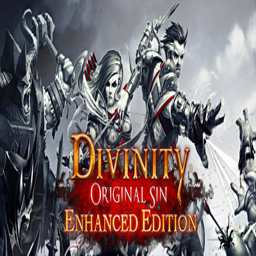

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 359320, title: Elite Dangerous, Score: 0.7316461801528931
선택된 게임의 content: Take control of your own starship in a cutthroat galaxy. Elite Dangerous is the definitive massively multiplayer space epic.
선택된 게임의 genres: ['Space Sim', 'Space', 'Open World', 'Exploration', 'Sci-fi', 'Simulation', 'Massively Multiplayer', 'Multiplayer', 'First-Person', 'Action', 'Adventure', 'Sandbox', 'VR', 'Online Co-Op', 'Trading', 'Singleplayer', 'RPG', 'Difficult', 'Strategy', 'TrackIR']


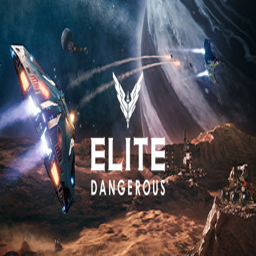

----------------------------------------------------------------------------------------------------


In [ ]:
# 스카이림
get_sim_game(loaded_model, '489830')

# 잘 추천 된 듯?

## The_Sims_4

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 1222670, 선택된 게임의 title: The Sims™ 4
선택된 게임의 content: Play with life and discover the possibilities. Unleash your imagination and create a world of Sims that’s wholly unique. Explore and customize every detail from Sims to homes–and much more.
선택된 게임의 genres: ['Life Sim', 'Character Customization', 'Simulation', 'Building', 'Casual', 'Sexual Content', 'Romance', 'Funny', 'Singleplayer', 'Relaxing', 'Cute', 'Family Friendly', 'Immersive Sim', 'Cartoony', 'Multiplayer', 'Fantasy', 'Beautiful', 'Realistic', 'Atmospheric', 'LGBTQ']


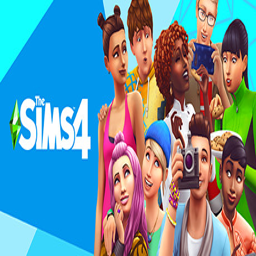

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1404210, title: Red Dead Online, Score: 0.7363157272338867
선택된 게임의 content: Step into the vibrant, ever-evolving world of Red Dead Online and experience life in frontier America. Chase down bounties, battle outlaw gangs and other players, hunt, fish and trade, search for exotic treasures, run Moonshine, and much more to discover in a world of astounding depth and detail.
선택된 게임의 genres: ['Action', 'Adventure', 'Open World', 'Multiplayer', 'Western', 'Shooter', 'Third-Person Shooter', 'Horses', 'Online Co-Op', 'Realistic', 'PvP', 'Singleplayer', 'Co-op', 'Character Customization', 'Story Rich', 'MMORPG', 'Controller', 'First-Person', 'Sexual Content', 'Psychological Horror']


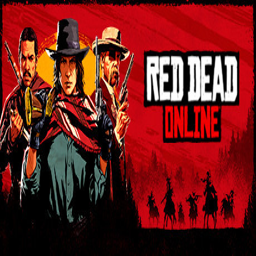

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1222140, title: Detroit: Become Human, Score: 0.7208252549171448
선택된 게임의 content: Detroit: Become Human puts the destiny of both mankind and androids in your hands, taking you to a near future where machines have become more intelligent than humans. Every choice you make affects the outcome of the game, with one of the most intricately branching narratives ever created.
선택된 게임의 genres: ['Choices Matter', 'Story Rich', 'Multiple Endings', 'Cinematic', 'Adventure', 'Singleplayer', 'Emotional', 'Beautiful', 'Sci-fi', 'Futuristic', 'Robots', 'Great Soundtrack', 'Dynamic Narration', 'Third Person', 'Atmospheric', 'Cyberpunk', 'Narration', 'Violent', 'Female Protagonist', 'Replay Value']


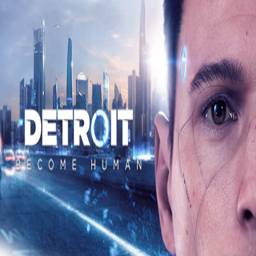

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 1262580, title: Need for Speed™ Payback, Score: 0.7206805944442749
선택된 게임의 content: Set in the underworld of Fortune Valley, you and your crew were divided by betrayal and reunited by revenge to take down The House, a nefarious cartel that rules the city’s casinos, criminals and cops. In this corrupt gambler’s paradise, the stakes are high and The House always wins.
선택된 게임의 genres: ['Racing', 'Combat Racing', 'Offroad', 'Vehicular Combat', 'Action', 'Multiplayer', 'Open World', 'Co-op', 'Adventure', 'Atmospheric', 'First-Person', 'Singleplayer', 'Sports', 'Online Co-Op', 'PvP', 'Controller', 'Arcade', 'Third Person', 'Strategy', 'Sandbox']


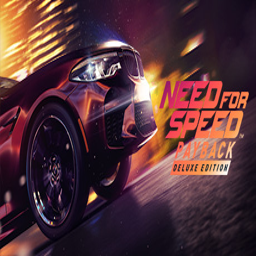

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 837470, title: Untitled Goose Game, Score: 0.7157231569290161
선택된 게임의 content: It's a lovely morning in the village and you are a horrible goose.
선택된 게임의 genres: ['Funny', 'Indie', 'Villain Protagonist', 'Comedy', 'Stealth', 'Cute', 'Puzzle', 'Co-op', 'Singleplayer', 'Multiplayer', 'Family Friendly', 'Physics', 'Colorful', 'Action', 'Sandbox', 'Adventure', 'Local Co-Op', 'Third Person', 'Local Multiplayer', 'Simulation']


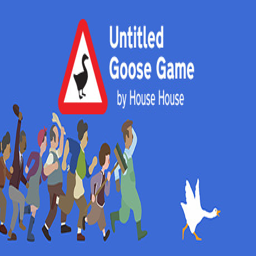

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1222700, title: A Way Out, Score: 0.7105807662010193
선택된 게임의 content: A Way Out is an exclusively co-op adventure where you play the role of one of two prisoners making their daring escape from prison.
선택된 게임의 genres: ['Co-op', 'Online Co-Op', 'Split Screen', 'Story Rich', 'Local Co-Op', 'Action-Adventure', 'Action', 'Third Person', 'Adventure', 'Crime', 'Conversation', 'Emotional', 'Atmospheric', 'Multiplayer', 'Sexual Content', 'Nudity', 'Violent', 'Cinematic', 'Indie', 'Singleplayer']


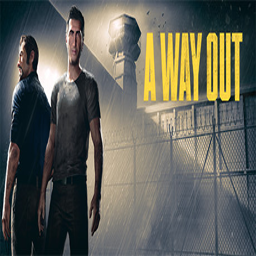

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 1259970, title: eFootball PES 2021 SEASON UPDATE, Score: 0.708859920501709
선택된 게임의 content: Celebrate 25 years of PES with the eFootball PES 2021 Season Update* - available at a special anniversary price!
선택된 게임의 genres: ['Sports', 'eSports', 'Realistic', 'Soccer', 'Multiplayer', 'Co-op', 'Local Multiplayer', 'Local Co-Op', 'Singleplayer', 'Online Co-Op', 'Football', 'Controller', 'Free to Play', 'Simulation', 'Team-Based']


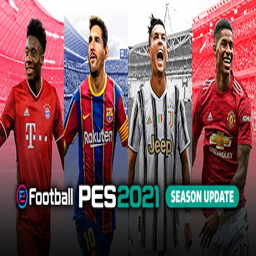

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 958850, title: Let It Flow, Score: 0.707292377948761
선택된 게임의 content: What happens when you let your Youtube community make a game? Well, you're looking at it. Chat tells me what to make and so I build it for them. I have no choice but to fulfill their wishes. Don't judge me.
선택된 게임의 genres: ['Action', 'Racing', 'Action-Adventure', 'Battle Royale', 'eSports', 'Sandbox', 'Shooter', 'Arena Shooter', 'Immersive Sim', 'Third-Person Shooter', '3D', 'Cartoony', 'Colorful', 'Cute', 'Third Person', 'Atmospheric', 'Education', 'Driving', 'Family Friendly', 'Flight']


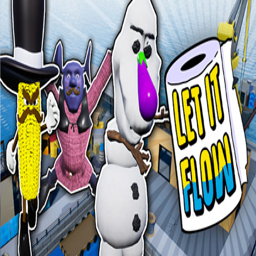

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 1241100, title: POLYGON: Multiplayer Shooter, Score: 0.7056697010993958
선택된 게임의 content: POLYGON is a dynamic multiplayer team 1st and 3rd person shooter. You have to battle on large-scale maps using various weapons with up to 32 players. Properly managing your existing arsenal and skills, you have to lead your team to victory!
선택된 게임의 genres: ['Free to Play', 'Action', 'Shooter', 'Indie', 'Massively Multiplayer', 'Simulation', 'Multiplayer', 'FPS', 'RPG', 'War', 'Online Co-Op', 'Tactical', 'Strategy', 'Casual', 'Co-op', 'Arcade', 'Military', 'Wargame', 'Sports', 'Early Access']


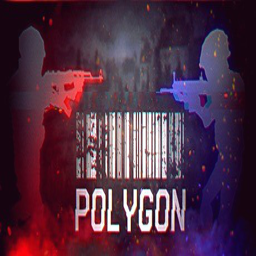

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 1222680, title: Need for Speed™ Heat, Score: 0.7048061490058899
선택된 게임의 content: Hustle by day and risk it all at night in Need for Speed™ Heat Deluxe Edition, a white-knuckle street racer, where the lines of the law fade as the sun starts to set.
선택된 게임의 genres: ['Racing', 'Open World', 'Multiplayer', 'Driving', 'Action', 'Adventure', 'Singleplayer', 'Co-op', 'Atmospheric', 'Combat Racing', 'Third Person', 'Sports', 'Arcade', 'First-Person', 'Online Co-Op', 'PvP', 'Split Screen', 'Character Customization', 'Destruction', 'Sexual Content']


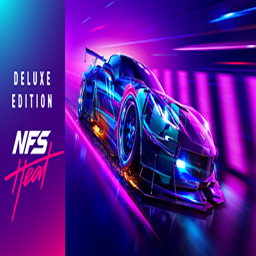

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 1184410, title: PAYDAY 2: Tailor Pack 1, Score: 0.6996033787727356
선택된 게임의 content: This content requires the base game PAYDAY 2 on Steam in order to play.
선택된 게임의 genres: ['Action', 'RPG', 'Gore', 'Violent']


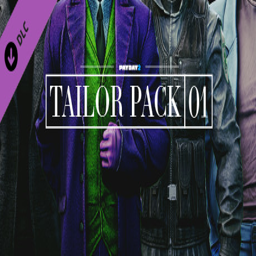

----------------------------------------------------------------------------------------------------


In [ ]:
# The_Sims_4
get_sim_game(loaded_model, '1222670')

# 모르겠어요

## DARK SOULS™: REMASTERED

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 570940, 선택된 게임의 title: DARK SOULS™: REMASTERED
선택된 게임의 content: Then, there was fire. Re-experience the critically acclaimed, genre-defining game that started it all. Beautifully remastered, return to Lordran in stunning high-definition detail running at 60fps.
선택된 게임의 genres: ['Souls-like', 'Education', 'Dark Fantasy', 'Action', 'Dark', 'RPG', 'Difficult', 'Fantasy', 'Atmospheric', 'Action RPG', 'Great Soundtrack', 'Multiplayer', 'Lore-Rich', 'Adventure', 'Story Rich', 'Replay Value', 'Third Person', 'Exploration', 'Character Customization', 'Soundtrack']


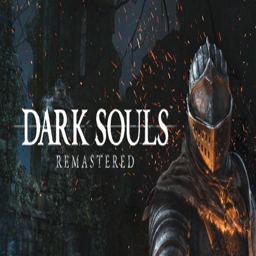

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 485510, title: Nioh: Complete Edition / 仁王 Complete Edition, Score: 0.7839328050613403
선택된 게임의 content: Ready to die? Experience the newest brutal action game from Team NINJA and Koei Tecmo Games. In the age of samurai, a lone traveler lands on the shores of Japan. He must fight his way through the vicious warriors and supernatural Yokai that infest the land in order to find that which he seeks.
선택된 게임의 genres: ['Souls-like', 'Action', 'RPG', 'Difficult', 'Hack and Slash', 'Dark Fantasy', 'Ninja', 'Third Person', 'JRPG', 'Action RPG', 'Singleplayer', 'Co-op', 'Multiplayer', 'Historical', 'Loot', 'Fantasy', 'Adventure', 'Atmospheric', 'Nudity', 'Great Soundtrack']


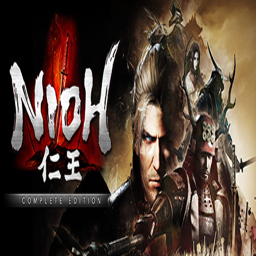

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 814380, title: Sekiro™: Shadows Die Twice - GOTY Edition, Score: 0.7799636721611023
선택된 게임의 content: Game of the Year - The Game Awards 2019 Best Action Game of 2019 - IGN Carve your own clever path to vengeance in the award winning adventure from developer FromSoftware, creators of Bloodborne and the Dark Souls series. Take Revenge. Restore Your Honor. Kill Ingeniously.
선택된 게임의 genres: ['Souls-like', 'Difficult', 'Action', 'Singleplayer', 'Ninja', 'Stealth', 'Adventure', 'Third Person', 'Open World', 'Story Rich', 'Atmospheric', 'Violent', 'Assassin', 'Dark Fantasy', 'Great Soundtrack', 'Hack and Slash', 'RPG', 'Gore', 'Dark', 'Rhythm']


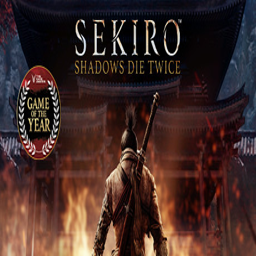

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 335300, title: DARK SOULS™ II: Scholar of the First Sin, Score: 0.7582650780677795
선택된 게임의 content: DARK SOULS™ II: Scholar of the First Sin brings the franchise’s renowned obscurity & gripping gameplay to a new level. Join the dark journey and experience overwhelming enemy encounters, diabolical hazards, and unrelenting challenge.
선택된 게임의 genres: ['Souls-like', 'Dark Fantasy', 'RPG', 'Difficult', 'Action', 'Third Person', 'Atmospheric', 'Action RPG', 'Co-op', 'Character Customization', 'Multiplayer', 'Adventure', 'Fantasy', 'Medieval', 'Dark', 'Singleplayer', 'Lore-Rich', 'Story Rich', 'PvP', 'Remake']


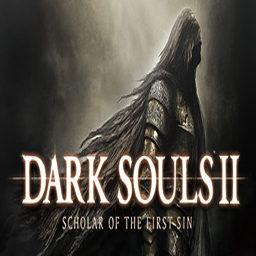

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 678950, title: DRAGON BALL FighterZ, Score: 0.7574724555015564
선택된 게임의 content: DRAGON BALL FighterZ is born from what makes the DRAGON BALL series so loved and famous: endless spectacular fights with its all-powerful fighters.
선택된 게임의 genres: ['Fighting', 'Anime', 'Action', '2D Fighter', 'Multiplayer', 'Competitive', 'Local Multiplayer', 'Controller', 'Great Soundtrack', '2.5D', 'Singleplayer', 'Arcade', 'eSports', 'Difficult', 'Fast-Paced', 'Story Rich', "Beat 'em up", 'Dragons', 'Adventure', 'Open World']


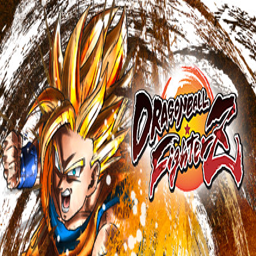

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 601150, title: Devil May Cry 5, Score: 0.7444086670875549
선택된 게임의 content: The ultimate Devil Hunter is back in style, in the game action fans have been waiting for.
선택된 게임의 genres: ['Action', 'Hack and Slash', 'Great Soundtrack', 'Character Action Game', 'Demons', 'Spectacle fighter', 'Third Person', 'Singleplayer', 'Violent', 'Stylized', 'Classic', 'Gore', 'Story Rich', 'Nudity', 'Multiplayer', 'Difficult', 'Controller', 'Adventure', 'Anime', 'Co-op']


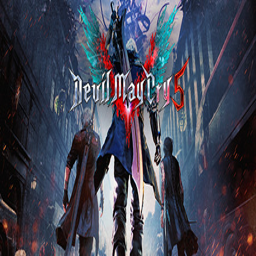

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 268910, title: Cuphead, Score: 0.7395128011703491
선택된 게임의 content: Cuphead is a classic run and gun action game heavily focused on boss battles. Inspired by cartoons of the 1930s, the visuals and audio are painstakingly created with the same techniques of the era, i.e. traditional hand drawn cel animation, watercolor backgrounds, and original jazz recordings.
선택된 게임의 genres: ['Difficult', 'Cartoon', 'Platformer', 'Great Soundtrack', 'Co-op', 'Local Co-Op', 'Hand-drawn', '2D', 'Indie', 'Retro', 'Multiplayer', 'Cartoony', 'Bullet Hell', 'Action', "Shoot 'Em Up", 'Side Scroller', 'Colorful', 'Singleplayer', 'Funny', 'Atmospheric']


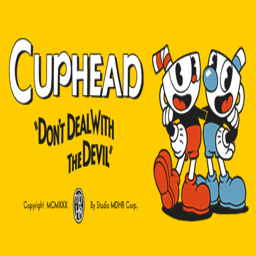

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 378540, title: The Surge, Score: 0.7381216883659363
선택된 게임의 content: Welcome to CREO, the megacorporation saving the world! A catastrophic event has knocked you out during the first day on the job… you wake up equipped with a heavy-grade exoskeleton, in a destroyed section of the complex.
선택된 게임의 genres: ['Souls-like', 'Action', 'RPG', 'Sci-fi', 'Difficult', 'Third Person', 'Singleplayer', 'Mechs', 'Violent', 'Hack and Slash', 'Open World', 'Robots', 'Exploration', 'Cyberpunk', 'Action RPG', 'Gore', 'Adventure', 'Horror', 'Futuristic', 'Multiplayer']


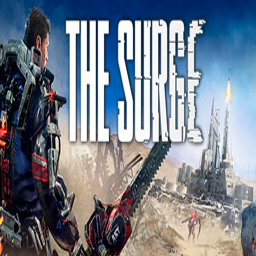

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 22490, title: Fallout: New Vegas, Score: 0.730236291885376
선택된 게임의 content: Welcome to Vegas. New Vegas. Enjoy your stay!
선택된 게임의 genres: ['RPG', 'Post-apocalyptic', 'Open World', 'Atmospheric', 'Story Rich', 'Action', 'Singleplayer', 'Survival', 'Adventure', 'Choices Matter', 'Great Soundtrack', 'First-Person', 'Classic', 'Western', 'Third Person', 'Shooter', 'Sci-fi', 'FPS', 'Gore', 'Horror']


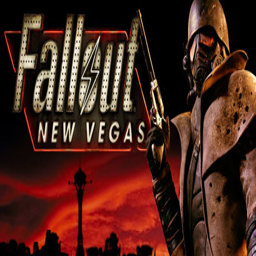

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 389730, title: TEKKEN 7, Score: 0.7294621467590332
선택된 게임의 content: Discover the epic conclusion of the long-time clan warfare between members of the Mishima family. Powered by Unreal Engine 4, the legendary fighting game franchise fights back with stunning story-driven cinematic battles and intense duels that can be enjoyed with friends and rivals.
선택된 게임의 genres: ['Fighting', 'Action', 'Multiplayer', 'Competitive', 'Arcade', 'Local Multiplayer', 'Controller', 'Great Soundtrack', 'Sports', 'Singleplayer', 'eSports', 'Character Customization', 'Difficult', '3D Fighter', 'Anime', 'Story Rich', "Beat 'em up", 'Nudity', 'Third Person', 'Sexual Content']


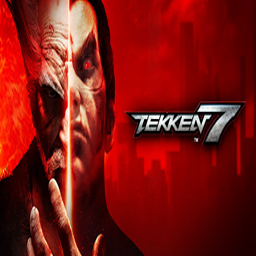

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 692850, title: Bloodstained: Ritual of the Night, Score: 0.7283533811569214
선택된 게임의 content: Bloodstained: Ritual of the Night is an exploration-focused, side-scroller action RPG by Koji Igarashi. Play as Miriam, an orphan scarred by an alchemist's curse that slowly crystallizes her body. Battle through a demon-infested castle and defeat its master to save yourself, and all of humanity!
선택된 게임의 genres: ['Metroidvania', 'RPG', 'Action', 'Female Protagonist', 'Adventure', 'Anime', 'Side Scroller', '2.5D', 'Platformer', 'Great Soundtrack', 'Dark Fantasy', 'Gothic', 'Exploration', 'Singleplayer', 'Crafting', '2D', 'Difficult', 'Nudity', 'Sexual Content', 'Multiplayer']


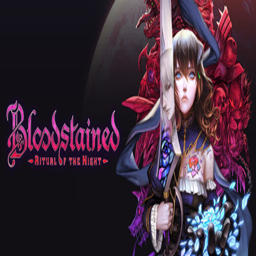

----------------------------------------------------------------------------------------------------


In [ ]:
# DARK SOULS™: REMASTERED
get_sim_game(loaded_model, '570940')

# 지은님 말로는 1~3위가 모두 이 게임을 하는 사람들이 무조건 하는 게임이라고는 함

## Need for Speed™ Heat

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 1222680, 선택된 게임의 title: Need for Speed™ Heat
선택된 게임의 content: Hustle by day and risk it all at night in Need for Speed™ Heat Deluxe Edition, a white-knuckle street racer, where the lines of the law fade as the sun starts to set.
선택된 게임의 genres: ['Racing', 'Open World', 'Multiplayer', 'Driving', 'Action', 'Adventure', 'Singleplayer', 'Co-op', 'Atmospheric', 'Combat Racing', 'Third Person', 'Sports', 'Arcade', 'First-Person', 'Online Co-Op', 'PvP', 'Split Screen', 'Character Customization', 'Destruction', 'Sexual Content']


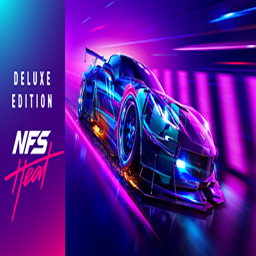

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 621060, title: PC Building Simulator, Score: 0.7643872499465942
선택된 게임의 content: Build and grow your very own computer repair enterprise as you learn to diagnose, fix and build PCs. With real-world licensed components and comprehensive hardware and software simulation, you can plan and bring your ultimate PC to life.
선택된 게임의 genres: ['Simulation', 'Education', 'Immersive Sim', 'Building', 'Management', 'First-Person', 'Life Sim', 'Casual', 'Sandbox', '3D', 'Relaxing', 'Realistic', 'Funny', 'Puzzle', 'Singleplayer', 'Modern', 'Inventory Management', 'Atmospheric', 'Hardware', 'Indie']


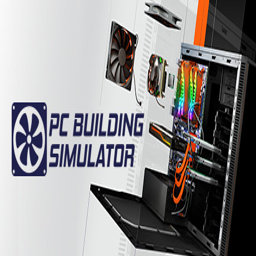

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1237970, title: Titanfall® 2, Score: 0.75159752368927
선택된 게임의 content: Respawn Entertainment gives you the most advanced titan technology in its new, single player campaign & multiplayer experience. Combine & conquer with new titans & pilots, deadlier weapons, & customization and progression systems that help you and your titan flow as one unstoppable killing force.
선택된 게임의 genres: ['FPS', 'Multiplayer', 'Action', 'Shooter', 'Mechs', 'Singleplayer', 'Sci-fi', 'Parkour', 'First-Person', 'Futuristic', 'PvP', 'Military', 'Combat', 'Team-Based', 'Time Travel', 'Fast-Paced', 'Hero Shooter', 'Violent', 'Gore', 'Co-op']


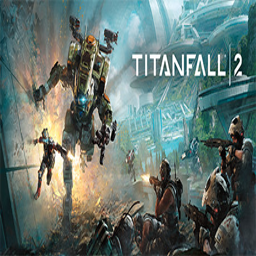

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 1237950, title: STAR WARS™ Battlefront™ II, Score: 0.7476972937583923
선택된 게임의 content: Be the hero in the ultimate STAR WARS™ battle fantasy with STAR WARS™ Battlefront™ II: Celebration Edition!
선택된 게임의 genres: ['Multiplayer', 'FPS', 'Shooter', 'Singleplayer', 'Third-Person Shooter', 'Action', 'Space', 'Co-op', 'Sci-fi', 'Vehicular Combat', 'Combat', 'Adventure', 'Online Co-Op', 'First-Person', 'Third Person', 'Aliens', 'PvP', 'Tactical', 'Character Customization', 'Controller']


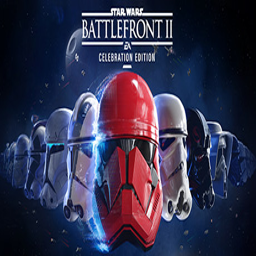

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1172470, title: Apex Legends™, Score: 0.7462942004203796
선택된 게임의 content: Apex Legends is the award-winning, free-to-play Hero shooter from Respawn Entertainment. Master an ever-growing roster of legendary characters with powerful abilities and experience strategic squad play and innovative gameplay in the next evolution of Hero Shooter and Battle Royale.
선택된 게임의 genres: ['Free to Play', 'Battle Royale', 'Multiplayer', 'Shooter', 'First-Person', 'PvP', 'Hero Shooter', 'Action', 'Team-Based', 'FPS', 'Character Customization', 'Sci-fi', 'Survival', 'Tactical', 'Funny', 'Loot', 'Lore-Rich', 'Cyberpunk', 'Cinematic', 'Science']


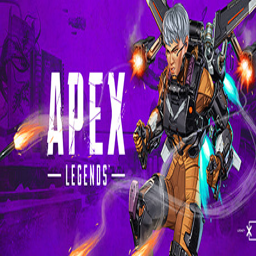

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1262560, title: Need for Speed™ Most Wanted, Score: 0.7438428401947021
선택된 게임의 content: The open-world action in Need for Speed Most Wanted gives you the freedom to drive your way. Hit jumps and shortcuts, switch cars, lie low or head for terrain that plays to your vehicle’s unique strengths. Fight your way past cops and rivals using skill, high-end car tech and tons of nitrous.
선택된 게임의 genres: ['Racing', 'Multiplayer', 'Driving', 'Open World', 'Competitive', 'Action', 'Automobile Sim', 'Arcade', 'Adventure', 'Combat Racing', 'First-Person', 'Vehicular Combat', 'Singleplayer', 'Third Person', 'Controller', 'Co-op', 'Split Screen']


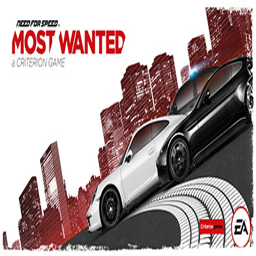

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 1172620, title: Sea of Thieves, Score: 0.7393171191215515
선택된 게임의 content: Sea of Thieves offers the essential pirate experience, from sailing and fighting to exploring and looting – everything you need to live the pirate life and become a legend in your own right. With no set roles, you have complete freedom to approach the world, and other players, however you choose.
선택된 게임의 genres: ['Adventure', 'Multiplayer', 'Open World', 'Pirates', 'Action', 'Co-op', 'Online Co-Op', 'PvP', 'Sailing', 'First-Person', 'Exploration', 'Naval', 'Funny', 'PvE', 'Atmospheric', 'Massively Multiplayer', 'Great Soundtrack', 'Swordplay', 'FPS', 'Singleplayer']


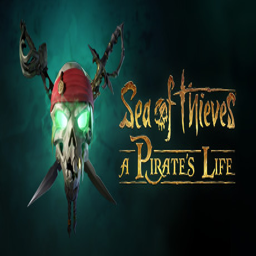

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 1262540, title: Need for Speed™, Score: 0.7358474731445312
선택된 게임의 content: Ready to own the streets? Get behind the wheel of iconic cars and floor it through Ventura Bay, a sprawling urban playground. Explore overlapping stories as you build your reputation – and your dream car – and become the ultimate racing icon.
선택된 게임의 genres: ['Racing', 'Multiplayer', 'Adventure', 'Action', 'Driving', 'Automobile Sim', 'Destruction', 'Simulation', 'Arcade', 'Singleplayer', 'Third Person', 'Combat Racing', 'First-Person', 'Co-op', 'Top-Down', 'Open World', 'Movie']


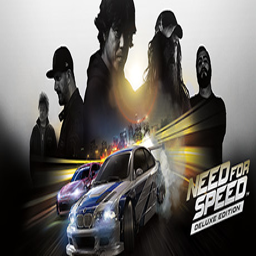

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 646910, title: The Crew™ 2, Score: 0.7257996797561646
선택된 게임의 content: Take on the American motorsports scene as you explore and dominate the land, air, and sea across the entire USA. With a wide variety of cars, bikes, boats, and planes, compete in a wide range of driving disciplines.
선택된 게임의 genres: ['Racing', 'Automobile Sim', 'Open World', 'Driving', 'Multiplayer', 'Massively Multiplayer', 'Action', 'Flight', 'Co-op', 'Singleplayer', 'Arcade', 'First-Person', 'Third Person', 'Simulation', 'Online Co-Op', 'America', 'Sports', 'Atmospheric', 'Sandbox', 'Adventure']


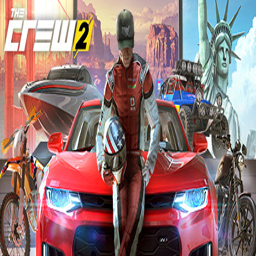

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 10190, title: Call of Duty®: Modern Warfare® 2, Score: 0.7246715426445007
선택된 게임의 content: The most-anticipated game of the year and the sequel to the best-selling first-person action game of all time, Modern Warfare 2 continues the gripping and heart-racing action as players face off against a new threat dedicated to bringing the world to the brink of collapse.
선택된 게임의 genres: ['Action', 'FPS', 'Multiplayer', 'Shooter', 'First-Person', 'Singleplayer', 'War', 'Military', 'Co-op', 'Online Co-Op', 'PvP', 'Great Soundtrack', 'Story Rich', 'Atmospheric', 'Adventure', 'Tactical', 'Linear', 'Strategy', 'Moddable', 'Controller']


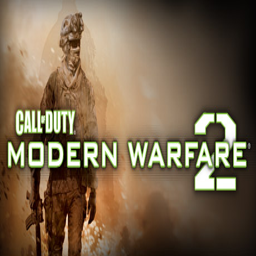

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 1174180, title: Red Dead Redemption 2, Score: 0.7243504524230957
선택된 게임의 content: Winner of over 175 Game of the Year Awards and recipient of over 250 perfect scores, RDR2 is the epic tale of outlaw Arthur Morgan and the infamous Van der Linde gang, on the run across America at the dawn of the modern age. Also includes access to the shared living world of Red Dead Online.
선택된 게임의 genres: ['Open World', 'Adventure', 'Story Rich', 'Western', 'Action', 'Multiplayer', 'Shooter', 'Realistic', 'Third-Person Shooter', 'Singleplayer', 'Atmospheric', 'Horses', 'Beautiful', 'Great Soundtrack', 'Third Person', 'Sandbox', 'Mature', 'First-Person', 'Gore', 'FPS']


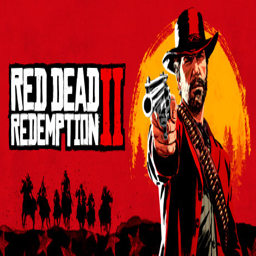

----------------------------------------------------------------------------------------------------


In [ ]:
# Need for Speed™ Heat
get_sim_game(loaded_model, '1222680')

# 나라면 할거 같긴 해요

## FIFA2021

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 1313860, 선택된 게임의 title: EA SPORTS™ FIFA 21
선택된 게임의 content: Football is back with EA SPORTS™ FIFA 21, featuring more ways to team up on the street or in the stadium to enjoy even bigger victories with friends.
선택된 게임의 genres: ['Sports', 'Soccer', 'PvP', 'Football', 'Competitive', 'Multiplayer', 'eSports', 'Controller', 'Simulation', 'Local Multiplayer', 'Realistic', 'Online Co-Op', 'Singleplayer', 'Local Co-Op', 'Co-op', 'Modern', 'Casual', 'Runner', 'Great Soundtrack', 'Souls-like']


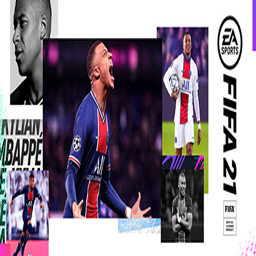

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1262540, title: Need for Speed™, Score: 0.7491084933280945
선택된 게임의 content: Ready to own the streets? Get behind the wheel of iconic cars and floor it through Ventura Bay, a sprawling urban playground. Explore overlapping stories as you build your reputation – and your dream car – and become the ultimate racing icon.
선택된 게임의 genres: ['Racing', 'Multiplayer', 'Adventure', 'Action', 'Driving', 'Automobile Sim', 'Destruction', 'Simulation', 'Arcade', 'Singleplayer', 'Third Person', 'Combat Racing', 'First-Person', 'Co-op', 'Top-Down', 'Open World', 'Movie']


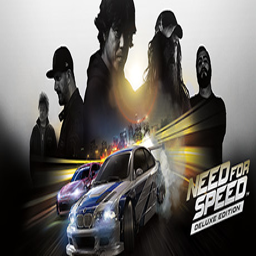

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1089350, title: NBA 2K20, Score: 0.7421138286590576
선택된 게임의 content: 2K continues to redefine what’s possible in sports gaming with NBA 2K20, featuring best in class graphics & gameplay, ground breaking game modes, and unparalleled player control and customization.
선택된 게임의 genres: ['Basketball', 'Sports', 'Simulation', 'Multiplayer', 'Singleplayer', 'Capitalism', 'Loot', 'Casual', 'Massively Multiplayer', 'Local Multiplayer', 'Controller', 'Character Customization', 'Realistic']


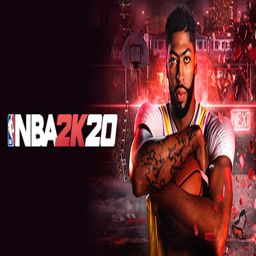

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 1259970, title: eFootball PES 2021 SEASON UPDATE, Score: 0.7394729852676392
선택된 게임의 content: Celebrate 25 years of PES with the eFootball PES 2021 Season Update* - available at a special anniversary price!
선택된 게임의 genres: ['Sports', 'eSports', 'Realistic', 'Soccer', 'Multiplayer', 'Co-op', 'Local Multiplayer', 'Local Co-Op', 'Singleplayer', 'Online Co-Op', 'Football', 'Controller', 'Free to Play', 'Simulation', 'Team-Based']


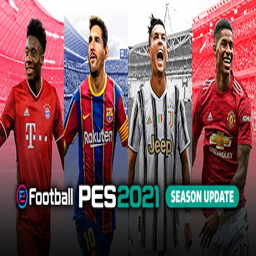

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1238880, title: Battlefield™ Hardline, Score: 0.7384233474731445
선택된 게임의 content: Strategy. Speed. Story. These are the core pillars of Battlefield™ Hardline, a cops vs. criminals experience unlike any other.
선택된 게임의 genres: ['Action', 'Multiplayer', 'Singleplayer', 'Shooter', 'FPS', 'War', 'First-Person', 'PvP', 'Gore', 'Violent', 'Tactical', 'Atmospheric', 'Crime']


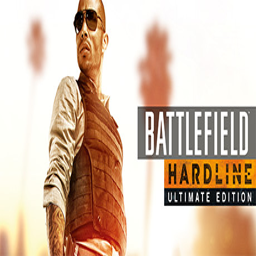

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1082180, title: TT Isle of Man Ride on the Edge 2, Score: 0.7366102337837219
선택된 게임의 content: Racing across an over 60 km long ultra-technical track at breakneck speed requiring realistic riding skills... that is the challenge that awaits in TT2! Lots of new features lie ahead: open world, reworked physics, classic motorbikes, and more…
선택된 게임의 genres: ['Simulation', 'Racing', 'Sports', 'Motorbike', 'Multiplayer', 'Open World', 'Singleplayer', 'Action', 'VR', 'Adventure', 'RPG', 'Arcade', 'Visual Novel', 'Exploration', 'Funny', 'Romance', 'PvP', 'Co-op', 'Remake', 'Nudity']


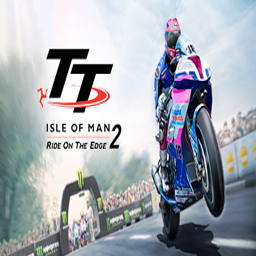

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 1214420, title: Tom Clancy's Rainbow Six® Siege - Year 5 Pass, Score: 0.7266013622283936
선택된 게임의 content: This content requires the base game Tom Clancy's Rainbow Six® Siege on Steam in order to play.
선택된 게임의 genres: ['Action', 'FPS', 'Multiplayer', 'Tactical', 'Mature', 'Psychological Horror']


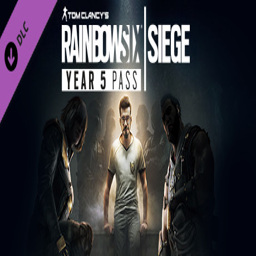

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 1172620, title: Sea of Thieves, Score: 0.7257401943206787
선택된 게임의 content: Sea of Thieves offers the essential pirate experience, from sailing and fighting to exploring and looting – everything you need to live the pirate life and become a legend in your own right. With no set roles, you have complete freedom to approach the world, and other players, however you choose.
선택된 게임의 genres: ['Adventure', 'Multiplayer', 'Open World', 'Pirates', 'Action', 'Co-op', 'Online Co-Op', 'PvP', 'Sailing', 'First-Person', 'Exploration', 'Naval', 'Funny', 'PvE', 'Atmospheric', 'Massively Multiplayer', 'Great Soundtrack', 'Swordplay', 'FPS', 'Singleplayer']


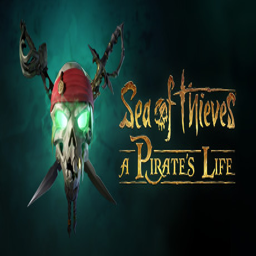

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 655500, title: MX Bikes, Score: 0.7168086767196655
선택된 게임의 content: MX Bikes is a realistic motocross simulator, based on a scratch built physics engine that accurately simulates motorcycle dynamics and setup options.
선택된 게임의 genres: ['Simulation', 'Sports', 'Racing', 'Motocross', 'Motorbike', 'Early Access', 'Multiplayer', 'VR']


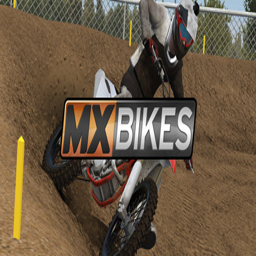

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 1359090, title: Zero Hour, Score: 0.7152144312858582
선택된 게임의 content: Zero Hour is a tactical FPS with online team-based game play that takes place in a variety of fictional locations interpreted in Bangladesh with Real-life scale & resource management. It brings a grounded, close quarter combat experience to the game.
선택된 게임의 genres: ['Action', 'Shooter', 'Tactical', 'FPS', 'Online Co-Op', 'Realistic', 'First-Person', 'Multiplayer', 'PvP', 'Military', 'Immersive Sim', 'Team-Based', '3D', 'Simulation', 'Strategy', 'Combat', 'Stealth', 'Violent', 'Early Access', 'PvE']


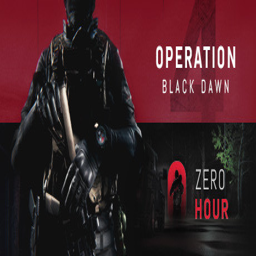

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 495420, title: State of Decay 2: Juggernaut Edition, Score: 0.7114552855491638
선택된 게임의 content: The dead have risen and civilization has fallen. Now it's up to you to gather survivors, scavenge for resources and build a community in a post-apocalyptic world – a world where you define what it means to survive in this ultimate zombie survival simulation.
선택된 게임의 genres: ['Survival', 'Open World', 'Zombies', 'Base Building', 'Co-op', 'Multiplayer', 'Simulation', 'Action', 'Online Co-Op', 'RPG', 'Post-apocalyptic', 'Sandbox', 'Third Person', 'Violent', 'Gore', 'Horror', 'Perma Death', 'Atmospheric', 'Replay Value', 'Great Soundtrack']


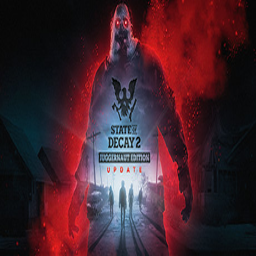

----------------------------------------------------------------------------------------------------


In [ ]:
# FIFA2021
get_sim_game(loaded_model, '1313860')

# 나라면 할거 같긴 해요

## PES2021

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 1259970, 선택된 게임의 title: eFootball PES 2021 SEASON UPDATE
선택된 게임의 content: Celebrate 25 years of PES with the eFootball PES 2021 Season Update* - available at a special anniversary price!
선택된 게임의 genres: ['Sports', 'eSports', 'Realistic', 'Soccer', 'Multiplayer', 'Co-op', 'Local Multiplayer', 'Local Co-Op', 'Singleplayer', 'Online Co-Op', 'Football', 'Controller', 'Free to Play', 'Simulation', 'Team-Based']


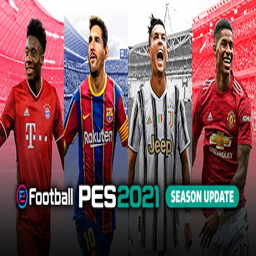

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 1038250, title: DIRT 5, Score: 0.7527389526367188
선택된 게임의 content: DIRT 5 is a fun, amplified, off-road arcade racing experience created by Codemasters. Blaze a trail on routes across the world, covering gravel, ice, snow and sand, with a roster of cars ranging from rally icons to trucks, to GT heroes.
선택된 게임의 genres: ['Racing', 'Driving', 'Offroad', 'Casual', 'Arcade', 'Action', '4 Player Local', 'Multiplayer', 'Local Multiplayer', 'Sports', 'Adventure', 'Automobile Sim', 'Atmospheric', 'Singleplayer', 'First-Person', 'Colorful', 'Realistic', 'PvP', 'Sandbox', 'Local Co-Op']


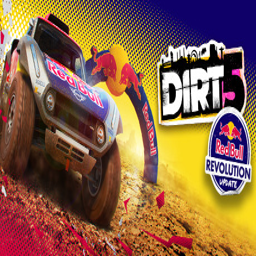

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 1030830, title: Mafia II: Definitive Edition, Score: 0.7493695020675659
선택된 게임의 content: War hero Vito Scaletta becomes entangled with the mob in hopes of paying his father’s debts. Vito works to prove himself, climbing the family ladder with crimes of larger reward and consequence.
선택된 게임의 genres: ['Action', 'Adventure', 'Crime', 'Open World', 'Violent', 'Sexual Content', 'Nudity', 'Gore', 'Third Person', 'Third-Person Shooter', 'Story Rich', 'Noir', 'Singleplayer', 'Shooter', 'Atmospheric']


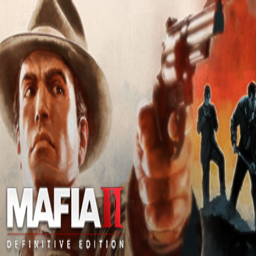

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 1262560, title: Need for Speed™ Most Wanted, Score: 0.7465469837188721
선택된 게임의 content: The open-world action in Need for Speed Most Wanted gives you the freedom to drive your way. Hit jumps and shortcuts, switch cars, lie low or head for terrain that plays to your vehicle’s unique strengths. Fight your way past cops and rivals using skill, high-end car tech and tons of nitrous.
선택된 게임의 genres: ['Racing', 'Multiplayer', 'Driving', 'Open World', 'Competitive', 'Action', 'Automobile Sim', 'Arcade', 'Adventure', 'Combat Racing', 'First-Person', 'Vehicular Combat', 'Singleplayer', 'Third Person', 'Controller', 'Co-op', 'Split Screen']


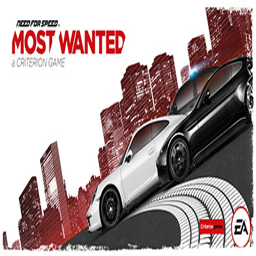

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 1238880, title: Battlefield™ Hardline, Score: 0.7434145212173462
선택된 게임의 content: Strategy. Speed. Story. These are the core pillars of Battlefield™ Hardline, a cops vs. criminals experience unlike any other.
선택된 게임의 genres: ['Action', 'Multiplayer', 'Singleplayer', 'Shooter', 'FPS', 'War', 'First-Person', 'PvP', 'Gore', 'Violent', 'Tactical', 'Atmospheric', 'Crime']


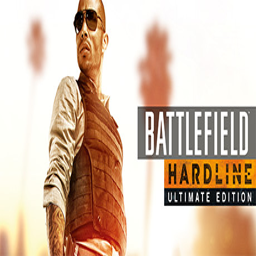

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 1313860, title: EA SPORTS™ FIFA 21, Score: 0.7394729852676392
선택된 게임의 content: Football is back with EA SPORTS™ FIFA 21, featuring more ways to team up on the street or in the stadium to enjoy even bigger victories with friends.
선택된 게임의 genres: ['Sports', 'Soccer', 'PvP', 'Football', 'Competitive', 'Multiplayer', 'eSports', 'Controller', 'Simulation', 'Local Multiplayer', 'Realistic', 'Online Co-Op', 'Singleplayer', 'Local Co-Op', 'Co-op', 'Modern', 'Casual', 'Runner', 'Great Soundtrack', 'Souls-like']


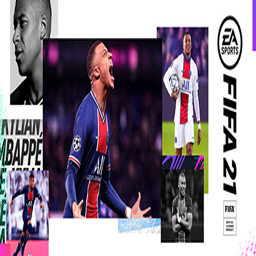

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 1262580, title: Need for Speed™ Payback, Score: 0.73907870054245
선택된 게임의 content: Set in the underworld of Fortune Valley, you and your crew were divided by betrayal and reunited by revenge to take down The House, a nefarious cartel that rules the city’s casinos, criminals and cops. In this corrupt gambler’s paradise, the stakes are high and The House always wins.
선택된 게임의 genres: ['Racing', 'Combat Racing', 'Offroad', 'Vehicular Combat', 'Action', 'Multiplayer', 'Open World', 'Co-op', 'Adventure', 'Atmospheric', 'First-Person', 'Singleplayer', 'Sports', 'Online Co-Op', 'PvP', 'Controller', 'Arcade', 'Third Person', 'Strategy', 'Sandbox']


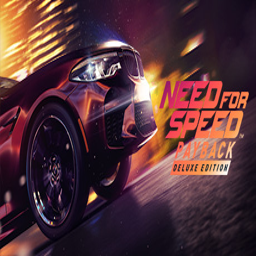

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 1080110, title: F1® 2020, Score: 0.7358543872833252
선택된 게임의 content: F1® 2020 allows you to create your F1® team for the very first time and race alongside the official teams and drivers. Alternatively, challenge your friends in new split-screen with casual race options for more relaxed racing. Compete on 22 circuits, with current and classic content.
선택된 게임의 genres: ['Racing', 'Simulation', 'Sports', 'Multiplayer', 'Automobile Sim', 'Difficult', 'Split Screen', 'Driving', 'Realistic', 'Management', 'Singleplayer', 'Strategy', 'Controller', 'VR', 'Local Multiplayer', 'Arcade']


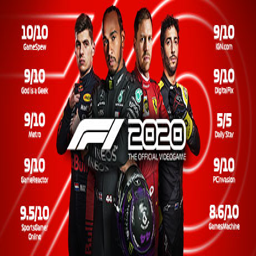

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 264803, title: Assassin’s Creed® IV Black Flag™ – Freedom Cry, Score: 0.7340806722640991
선택된 게임의 content: This content requires the base game Assassin’s Creed® IV Black Flag™ on Steam in order to play.
선택된 게임의 genres: ['Adventure', 'Action', 'Open World', 'Stealth', 'Pirates', 'Assassin', 'Historical']


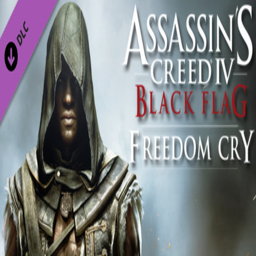

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 960990, title: Beyond: Two Souls, Score: 0.7329582571983337
선택된 게임의 content: A unique psychological action thriller delivered by A-list Hollywood performances by Elliot Page and Willem Dafoe, Beyond: Two Souls takes you on a thrilling journey across the globe as you play out the remarkable life of Jodie Holmes.
선택된 게임의 genres: ['Adventure', 'Choices Matter', 'Story Rich', 'Female Protagonist', 'Singleplayer', 'Emotional', 'Cinematic', 'Sci-fi', 'Dynamic Narration', 'Violent', 'Third Person', 'Narration', 'Great Soundtrack', 'Quick-Time Events', 'Beautiful', 'Thriller', 'Horror', 'Atmospheric', 'Drama', 'Co-op']


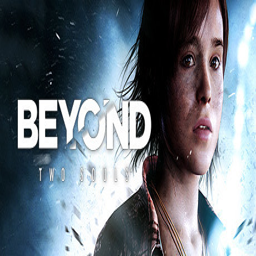

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 1263850, title: Football Manager 2021, Score: 0.7289321422576904
선택된 게임의 content: New additions and game upgrades deliver added levels of depth, drama and football authenticity. FM21 empowers you like never before to develop your skills and command success at your club.
선택된 게임의 genres: ['Sports', 'Simulation', 'Management', 'Singleplayer', 'Soccer', 'Multiplayer', 'Football', 'Strategy']


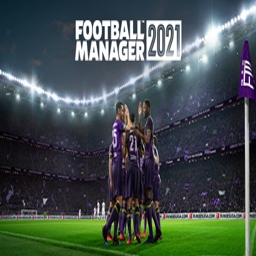

----------------------------------------------------------------------------------------------------


In [ ]:
# PES2021
get_sim_game(loaded_model, '1259970')

# 나라면 할거 같긴 해요

## PLAYERUNKNOWN'S BATTLEGROUNDS

----------------------------------------------------------------------------------------------------
선택된 게임의 ID: 578080, 선택된 게임의 title: PLAYERUNKNOWN'S BATTLEGROUNDS
선택된 게임의 content: PLAYERUNKNOWN'S BATTLEGROUNDS is a battle royale shooter that pits 100 players against each other in a struggle for survival. Gather supplies and outwit your opponents to become the last person standing.
선택된 게임의 genres: ['Survival', 'Shooter', 'Multiplayer', 'Battle Royale', 'FPS', 'PvP', 'Third-Person Shooter', 'Action', 'Online Co-Op', 'Tactical', 'Co-op', 'First-Person', 'Strategy', 'Early Access', 'Competitive', 'Third Person', 'Team-Based', 'Difficult', 'Simulation', 'Stealth']


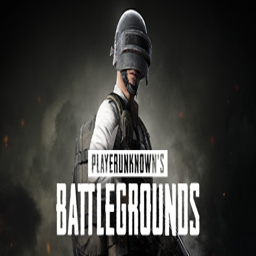

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP1 게임의 ID: 460930, title: Tom Clancy's Ghost Recon® Wildlands, Score: 0.7648487091064453
선택된 게임의 content: Create a team with up to 3 friends in Tom Clancy’s Ghost Recon® Wildlands and enjoy the ultimate military shooter experience set in a massive, dangerous, and responsive open world.
선택된 게임의 genres: ['Open World', 'Shooter', 'Co-op', 'Action', 'Multiplayer', 'Tactical', 'Stealth', 'Third-Person Shooter', 'Singleplayer', 'Military', 'FPS', 'Online Co-Op', 'Adventure', 'Third Person', 'Survival', 'Strategy', 'Sandbox', 'First-Person', 'Atmospheric', 'PvP']


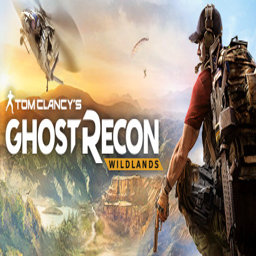

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP2 게임의 ID: 433850, title: Z1 Battle Royale, Score: 0.7625105381011963
선택된 게임의 content: Z1 Battle Royale is a Free to Play, fast-paced, action arcade, competitive Battle Royale. Staying true to its "King of the Kill" roots, the game has been revamped and restored to the classic feel, look, and gameplay everyone fell in love with. Play solo, duos, or fives and be the last ones standing.
선택된 게임의 genres: ['Survival', 'Massively Multiplayer', 'Multiplayer', 'Open World', 'Battle Royale', 'PvP', 'FPS', 'Action', 'Shooter', 'Free to Play', 'Third-Person Shooter', 'Zombies', 'Co-op', 'Early Access', 'Online Co-Op', 'Adventure', 'First-Person', 'Violent', 'Gore', 'Walking Simulator']


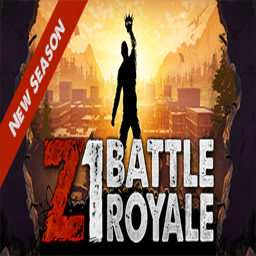

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP3 게임의 ID: 418460, title: Rising Storm 2: Vietnam, Score: 0.7595815062522888
선택된 게임의 content: Red Orchestra Series' take on Vietnam: 64-player MP matches; 20+ maps; US Army & Marines, PAVN/NVA, NLF/VC; Australians and ARVN forces; 50+ weapons; 4 flyable helicopters; mines, traps and tunnels; Brutal. Authentic. Gritty. Character customization. And napalm in the morning.
선택된 게임의 genres: ['FPS', 'War', 'Realistic', 'Multiplayer', 'Military', 'Shooter', 'Tactical', 'Action', 'First-Person', 'Historical', 'Team-Based', 'Simulation', 'Gore', 'Atmospheric', 'Cold War', 'Massively Multiplayer', 'Violent', 'Strategy', 'Singleplayer', 'Indie']


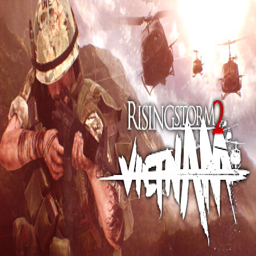

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP4 게임의 ID: 365590, title: Tom Clancy’s The Division™, Score: 0.7548604011535645
선택된 게임의 content: After a deadly pandemic sweeps through New York, it's up to Agents to save what remains. Complete missions, explore the Dark Zone, and fight back enemy factions alone or with 3 friends. Experience a full endgame offering you new PvP and PvE modes.
선택된 게임의 genres: ['Open World', 'Multiplayer', 'Looter Shooter', 'Third-Person Shooter', 'Action', 'Co-op', 'Shooter', 'RPG', 'Online Co-Op', 'Post-apocalyptic', 'Survival', 'Massively Multiplayer', 'Tactical', 'Third Person', 'MMORPG', 'Singleplayer', 'Adventure', 'Atmospheric', 'FPS', 'Stealth']


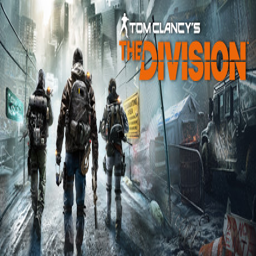

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP5 게임의 ID: 304390, title: FOR HONOR™, Score: 0.750306248664856
선택된 게임의 content: Carve a path of destruction through an intense, believable battlefield in For Honor.
선택된 게임의 genres: ['Medieval', 'Action', 'Swordplay', 'Multiplayer', 'PvP', 'Fighting', 'Third Person', 'War', 'Co-op', 'Gore', 'Singleplayer', 'Online Co-Op', 'Hack and Slash', 'Realistic', 'Strategy', 'Atmospheric', 'RPG', 'Fantasy', 'MOBA', 'Story Rich']


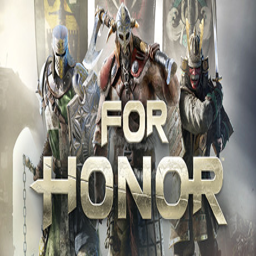

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP6 게임의 ID: 239140, title: Dying Light, Score: 0.7471938133239746
선택된 게임의 content: First-person action survival game set in a post-apocalyptic open world overrun by flesh-hungry zombies. Roam a city devastated by a mysterious virus epidemic. Scavenge for supplies, craft weapons, and face hordes of the infected.
선택된 게임의 genres: ['Zombies', 'Survival Horror', 'Horror', 'Online Co-Op', 'Open World', 'Parkour', 'First-Person', 'Open World Survival Craft', 'Survival', 'Action', 'FPS', 'Gore', 'PvP', 'PvE', 'Stealth', 'Post-apocalyptic', 'Story Rich', 'Hack and Slash', 'Action RPG', 'RPG']


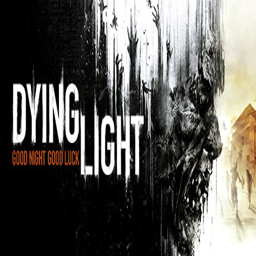

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP7 게임의 ID: 322500, title: SUPERHOT, Score: 0.7448542714118958
선택된 게임의 content: SUPERHOT is the smash-hit FPS where time moves only when you move. No regenerating health bars. No conveniently placed ammo drops. It's you, alone, outnumbered and outgunned. Snatch weapons from fallen enemies to shoot, slice and dodge through a truly cinematic hurricane of slow-motion bullets.
선택된 게임의 genres: ['Action', 'FPS', 'Bullet Time', 'Time Manipulation', 'Indie', 'First-Person', 'Singleplayer', 'Shooter', 'Puzzle', 'Minimalist', 'Short', 'Difficult', 'Cyberpunk', 'Kickstarter', 'Violent', 'Fast-Paced', 'Sci-fi', 'Casual', 'Adventure', 'Gore']


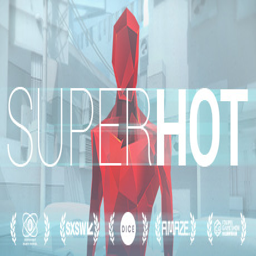

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP8 게임의 ID: 730, title: Counter-Strike: Global Offensive, Score: 0.7435100674629211
선택된 게임의 content: Counter-Strike: Global Offensive (CS: GO) expands upon the team-based action gameplay that it pioneered when it was launched 19 years ago. CS: GO features new maps, characters, weapons, and game modes, and delivers updated versions of the classic CS content (de_dust2, etc.).
선택된 게임의 genres: ['FPS', 'Shooter', 'Multiplayer', 'Competitive', 'Action', 'Team-Based', 'eSports', 'Tactical', 'First-Person', 'PvP', 'Online Co-Op', 'Co-op', 'Strategy', 'Military', 'War', 'Difficult', 'Trading', 'Realistic', 'Fast-Paced', 'Moddable']


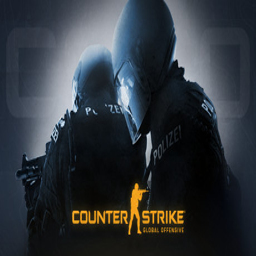

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP9 게임의 ID: 236870, title: HITMAN™, Score: 0.7396360635757446
선택된 게임의 content: There is a world beyond ours. Beyond nations, justice, ethics. It never sleeps. It exists everywhere. And once you enter....there is no going back. Welcome to the World of Assassination. You are Agent 47, the world's ultimate assassin.
선택된 게임의 genres: ['Stealth', 'Action', 'Assassin', 'Third Person', 'Singleplayer', 'Tactical', 'Shooter', 'Open World', 'Atmospheric', 'Crime', 'Sandbox', 'Strategy', 'Story Rich', 'Episodic', 'Third-Person Shooter', 'Adventure', 'Great Soundtrack', 'Heist', 'Illuminati', 'Nudity']


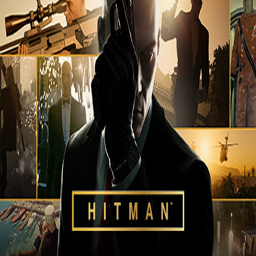

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
TOP10 게임의 ID: 271590, title: Grand Theft Auto V, Score: 0.7379626035690308
선택된 게임의 content: Grand Theft Auto V for PC offers players the option to explore the award-winning world of Los Santos and Blaine County in resolutions of up to 4k and beyond, as well as the chance to experience the game running at 60 frames per second.
선택된 게임의 genres: ['Open World', 'Action', 'Multiplayer', 'Automobile Sim', 'Crime', 'Third Person', 'First-Person', 'Shooter', 'Adventure', 'Mature', 'Singleplayer', 'Third-Person Shooter', 'Racing', 'Co-op', 'Atmospheric', 'Sandbox', 'Funny', 'Great Soundtrack', 'Comedy', 'Moddable']


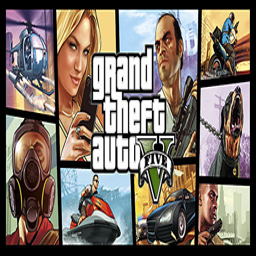

----------------------------------------------------------------------------------------------------


In [ ]:
# PLAYERUNKNOWN'S BATTLEGROUNDS
get_sim_game(loaded_model, '578080')

# 나라면 할거 같긴 해요

생각보다 매우 학습이 잘 된 듯함

그 시기에 해당 게임을 한 유저들 사이에서 유행했던 게임 위주로 추천이 이루어짐

시간에 영향을 많이 받는 모델임